In [4]:
import numpy as np
import IPython.display
import librosa
import librosa.display
import matplotlib.pyplot as plt
import os
import shutil
from collections import defaultdict
from random import shuffle
import keras
from keras.datasets import mnist
from keras.models import Sequential, load_model
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras import backend as K
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from keras.utils import np_utils
import pickle
from collections import Counter
import keras
from keras.models import Sequential, Model
from keras.layers import Dense, Dropout, Flatten, Activation, BatchNormalization, regularizers
from keras.layers.noise import GaussianNoise
from keras.layers import Conv2D, MaxPooling2D
from keras import backend as K
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras.utils.np_utils import to_categorical
from sklearn import metrics
import random
import numpy as np
import matplotlib.pyplot as plt
from sklearn import svm, datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
import sklearn
from sklearn import mixture
import itertools
import wave
import contextlib
%matplotlib inline

Using TensorFlow backend.


### Features

In [2]:
def plot(qwe):
    fig = plt.figure(figsize=(15, 10))
    ax = fig.add_subplot(111)
    # ax.set_title(c)
    plt.imshow(qwe)

In [3]:
def _read_wav(file_path):
    try:
        sr, d = wavfile.read(file_path)

        if not str(d.dtype).startswith('float'):
            if d.dtype == 'int16':
                nb_bits = 16
            elif d.dtype == 'int32':
                nb_bits = 32
            else:
                print d.dtype, d
                raise Exception('???')

            max_nb_bit = float(2 ** (nb_bits - 1))
            d = d / (max_nb_bit + 1.0)

        if len(d.shape) == 2:
            d = d[:, 0]

        return d, sr
    except:
        # print traceback.format_exc()
        y, sr = librosa.load(file_path, sr=None)
        return y, sr

In [4]:
def _get_wav_mfcc(values, sr, winlen=25, winstep=15, n_mels=128, n_mfcc=13, mfccd=False, mfccdd=False, norm_mfcc=False, fmin=0, fmax=6000, **kwargs):
    winlen = int((winlen / 1000.0) * sr)
    winstep = int((winstep / 1000.0) * sr)

    mfcc = librosa.feature.mfcc(
        y=values,
        sr=sr,
        n_fft=winlen,
        n_mfcc=n_mfcc,
        n_mels=n_mels,
        hop_length=winstep,
        fmin=fmin,
        fmax=fmax
    )
    
    if norm_mfcc:
        mfcc = (mfcc - mfcc.mean()) / mfcc.var()

    blocks = [mfcc]

    if mfccd:
        d = librosa.feature.delta(mfcc)
        blocks.append(d)
    if mfccdd:
        dd = librosa.feature.delta(mfcc, order=2)
        blocks.append(dd)

    return np.vstack(blocks)


# Computing SDC
# From src:
# http://webcache.googleusercontent.com/search?q=cache:y_zQF8CnrysJ:www-lium.univ-lemans.fr/sidekit/_modules/frontend/features.html+&cd=2&hl=ru&ct=clnk&gl=ru&lr=lang_be%7Clang_ru&client=ubuntu

def _compute_delta(features, win=3, **kwargs):
    x = np.zeros((features.shape[0] + 2 * win, features.shape[1]), dtype=np.float32)
    x[:win, :] = features[0, :]
    x[win:-win, :] = features
    x[-win:, :] = features[-1, :]

    delta = np.zeros(x.shape, dtype=np.float32)
    
    filt = np.zeros(2 * win + 1, dtype=np.float32)
    filt[0] = -1
    filt[-1] = 1

    for i in range(features.shape[1]):
        delta[:, i] = np.convolve(features[:, i], filt)

    return delta[win:-win, :]


def _get_sdc_features(cep, d=1, p=3, k=7, **kwargs):
    """
    Compute the Shifted-Delta-Cepstral features for language identification
    
    :param cep: matrix of feature, 1 vector per line
    :param d: represents the time advance and delay for the delta computation
    :param k: number of delta-cepstral blocks whose delta-cepstral 
       coefficients are stacked to form the final feature vector
    :param p: time shift between consecutive blocks.
    
    return: cepstral coefficient concatenated with shifted deltas
    """

    y = np.r_[
        np.resize(cep[0, :], (d, cep.shape[1])),
        cep,
        np.resize(cep[-1, :], (k * 3 + d, cep.shape[1]))
    ]

    delta = _compute_delta(y, win=d)
    sdc = np.empty((cep.shape[0], cep.shape[1] * k))

    idx = np.zeros(delta.shape[0], dtype='bool')
    for ii in range(k):
        idx[d + ii * p] = True
    for ff in range(len(cep)):
        sdc[ff, :] = delta[idx, :].reshape(1, -1)
        idx = np.roll(idx, 1)
    return sdc


def _get_wav_spectrogram(values, sr, winlen=25, winstep=15, n_mels=128, **kwargs):
    # ms to number of samples
    winlen = int((winlen / 1000.0) * sr)
    winstep = int((winstep / 1000.0) * sr)

    S = librosa.feature.melspectrogram(
        y=values,
        sr=sr,
        hop_length=winstep,
        n_fft=winlen,
        n_mels=n_mels,
    )

    log_S = librosa.power_to_db(S, ref=np.max)
    return log_S

In [5]:
def _get_columns_silence_flags(cur_mfccs, silence_percentile=15, **kwargs):
    percentile = np.percentile(cur_mfccs[0], silence_percentile)
    left_cols = []
    for i, v in enumerate(cur_mfccs[0]):
        if v >= percentile:
            left_cols.append(True)
        else:
            left_cols.append(False)
    return left_cols
        

def get_wav_feature(wav_path, remove_silence=False, **kwargs):
    values, sr = _read_wav(wav_path)
    
#     # N1
#     mfccs = _get_wav_mfcc(values, sr, **kwargs)
#     spectrogram = _get_wav_spectrogram(values, sr, **kwargs)
#     return np.vstack([mfccs, spectrogram])
    
    # N2
    mfccs = _get_wav_mfcc(values, sr, **kwargs)
    sdcs_mfcc = _get_sdc_features(mfccs[:13, :].T, **kwargs).T
    sdcs_d = _get_sdc_features(mfccs[13:26, :].T, **kwargs).T
    sdcs_dd = _get_sdc_features(mfccs[26:39, :].T, **kwargs).T
    res = np.vstack([mfccs, sdcs_mfcc, sdcs_d, sdcs_dd])
    
    if remove_silence:
        flags = _get_columns_silence_flags(mfccs, **kwargs)
        res = res[:, flags]

    return res

In [6]:
# values, sr = _read_wav(test_file_path)
# mfccs = _get_wav_mfcc(values, sr)
# plot(mfccs[:, _get_columns_silence_flags(mfccs)])
# plot(mfccs)

(91, 171)


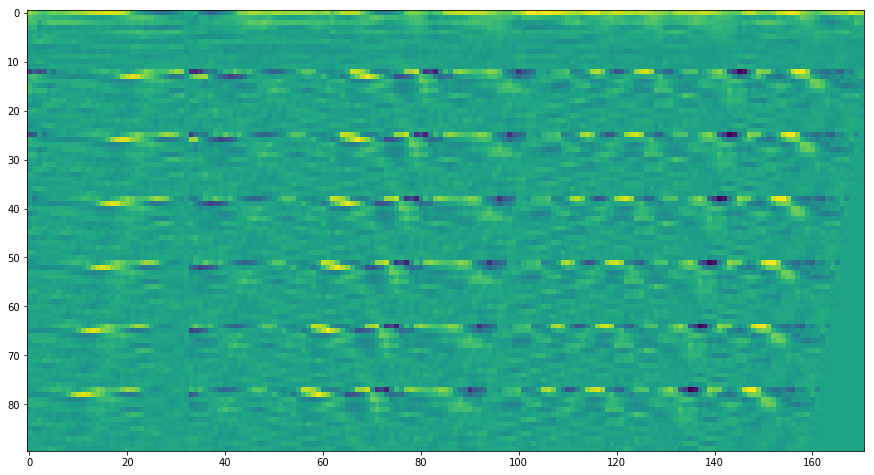

In [28]:
test_file_path = '/home/kolegor/Study/Master/Work/data/use1/wav_splitted_3/AncientGreek/histories1_01_thucydides_64kb.mp3.wav.chunk006.wav'
f = get_wav_feature(test_file_path, d=2, p=2, k=6, mfccd=False, mfccdd=False, remove_silence=True)
print f.shape
f = f[1:, :]
plot(f)

### Util

In [12]:
def plot_confusion_matrix(y_true, y_pred, classes, cm=None, normalize=False, title=None, cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    if cm is None:
        # Compute confusion matrix
        cm = confusion_matrix(y_true, y_pred)
        # Only use the labels that appear in the data
        classes = classes[unique_labels(y_true, y_pred)]
    else:
        classes = classes
    
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    fig, ax = plt.subplots(figsize=(15, 6))
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

In [13]:
LANGUAGES_DIR = '/home/kolegor/Study/Master/Work/data/use1/wav_splitted_3/'

In [14]:
def get_known_languages():
    return os.listdir(LANGUAGES_DIR)[::-1]

def get_language_files(language):
    result = []
    for filename in os.listdir(LANGUAGES_DIR + language):
        result.append(os.path.join(LANGUAGES_DIR, language, filename))
    return result

In [15]:
MAP_CLASS_TO_LANGUAGE = dict(enumerate(get_known_languages()))
MAP_LANGUAGE_TO_CLASS = dict((v, k) for k, v in MAP_CLASS_TO_LANGUAGE.iteritems())
MAP_LANGUAGE_TO_FILES_LIST = dict((l, get_language_files(l)) for l in MAP_LANGUAGE_TO_CLASS)
MAP_CLASS_TO_FILES_LIST = dict((MAP_LANGUAGE_TO_CLASS[l], get_language_files(l)) for l in MAP_LANGUAGE_TO_CLASS)
print sum(len(_q) for _, _q in MAP_CLASS_TO_FILES_LIST.iteritems())

32516


In [16]:
def create_language_features(target_shape, language, base_features_folder, uid, feature_extractor):
    files = MAP_LANGUAGE_TO_FILES_LIST[language]
    print ' * Extracting {} for {} files ({})'.format(feature_extractor, len(files), language)
    
    result_dump = []
    bad_files = []
    
    for j, filepath in enumerate(files):
        if j % 100 == 0:
            print j, len(files)

        cur_features = feature_extractor(filepath)
        if target_shape and cur_features.shape != target_shape:
            bad_files.append(filepath)
            print 'BAD', filepath
        else:
            result_dump.append(cur_features)
    
    if bad_files:
        print bad_files

    if not os.path.exists(base_features_folder):
        os.makedirs(base_features_folder)
    
    print ' * Saving features'
    new_dump = os.path.join(base_features_folder, u'{}__{}.pickle'.format(uid, language))

    try:
        with open(new_dump, 'w') as outf:
            pickle.dump(result_dump, outf)
        return None
    except:
        return result_dump

    
def load_languages_features(base_folder, uid, languages):
    by_class = dict()
    for language in languages:
        dump_path = u'{}/{}__{}.pickle'.format(base_folder, uid, language)
        
        try:
            print 'Loading {}'.format(language)
            with open(dump_path, 'r') as inf:
                by_class[MAP_LANGUAGE_TO_CLASS[language]] = pickle.load(inf)
        except:
            print ' * Exception loading language', language
    return by_class

In [17]:
# for language in get_known_languages()[9:]:
#     print ' !!! ', language
#     _ = create_language_features(
#         None,  # (273, 201),
#         language,
#         '/home/kolegor/Study/Master/Work/data/features_by_language/',
#         'mfccddd_sdc_sdcd_sdcdd_d2p1k5__removed_silence#',
#         lambda f: get_wav_feature(f, d=2, p=1, k=5, mfccd=True, mfccdd=True, remove_silence=True)
#     )

In [18]:
# FEATURES = load_languages_features(
#     '/home/kolegor/Study/Master/Work/data/features_by_language/',
#     'mfccddd_sdc_sdcd_sdcdd_d2p1k5__removed_silence#',  # 'mfccddd_sdc_sdcd_sdcdd_d2p2k6#',
#     ['Latvian', 'Russian', 'Swedish', 'Portuguese', 'Hebrew', 'French', 'Dutch', 'Spanish']  # , 'Italian', 'French']
# )

### Manual feature extraction

In [19]:
# Manual feature extraction
def calculate_all_features(target_shape, max_per_class=None, verbose=True, max_class=None, **kwargs):
    features_files_by_class = dict()
    for i, (c, files) in enumerate(sorted(MAP_CLASS_TO_FILES_LIST.iteritems())):
        if max_class is not None and c > max_class:
            break
        if verbose:
            print i, len(MAP_CLASS_TO_FILES_LIST), MAP_CLASS_TO_LANGUAGE[c]
        features_files_by_class[c] = list()
        for j, f in enumerate(files):
            if verbose and j % 100 == 0:
                print j, len(files) 
            if max_per_class and j > max_per_class:
                break
            cur_features = get_wav_feature(f, **kwargs)
            features_files_by_class[c].append(cur_features)
            # if verbose and j % 100 == 0:
                # print cur_features.shape
                # plot(cur_features)
                # plt.show()
    return features_files_by_class

In [20]:
# FEATURES = calculate_all_features(
#     (None, None),
#     max_class=10, max_per_class=5, d=2, p=2, k=6, mfccd=False, mfccdd=False, norm_mfcc=False,
#     remove_silence=False, silence_percentile=20
# )

In [21]:
# FEATURES = calculate_all_features(
#     (None, None),
#     max_class=3, d=2, p=2, k=6, mfccd=True, mfccdd=True, norm_mfcc=False,
#     remove_silence=True, silence_percentile=20
# )
# pickle.dump(FEATURES, open('/home/kolegor/features_to_10_reversed__with_sdc__and_sdc_for_d_and_dd.pickle', 'w'))
# FEATURES = pickle.load(open('/home/kolegor/features_to_10_reversed__with_sdc__and_sdc_for_d_and_dd.pickle', 'r'))

In [50]:
def _generator_features_extractor(file_path):
    return get_wav_feature(file_path, d=2, p=1, k=5, mfccd=True, mfccdd=True, remove_silence=True)


class DatasetGenerator(object):
    def __init__(self, class_to_files, batch_size):
        self.batch_size = batch_size
        self.class_to_files = class_to_files
        self.classes = list(set(self.class_to_files))
        
        if batch_size % len(self.class_to_files) != 0:
            raise ValueError(u'batch_size should be devided by number of classes {}'.format(len(class_to_files)))
        self.language_vectors_in_batch = batch_size / len(self.class_to_files)
        
        self.class_to_vector = dict()
        for c, _ in self.class_to_files.iteritems():
            class_vector = [0.0 for _ in xrange(len(self.class_to_files))]
            class_vector[c] = 1.0
            self.class_to_vector[c] = class_vector
        
        self._files_generators_by_class = dict()
        for c, _ in self.class_to_files.iteritems():
            self._files_generators_by_class[c] = self._get_class_generator(c)
        
        self._queue_by_class = defaultdict(list)
    
    def _get_class_generator(self, c):
        random.shuffle(self.class_to_files[c])
        return iter(self.class_to_files[c])

    def _get_next_class_file(self, c):
        gen = self._files_generators_by_class[c]
        try:
            file_path = next(gen)
        except StopIteration as e:
            gen = self._get_class_generator(c)
            file_path = next(gen)
            self._files_generators_by_class[c] = gen
        return file_path
    
    def _get_next_class_vector(self, c):
        if self._queue_by_class[c]:
            return self._queue_by_class[c].pop()
        file_path = self._get_next_class_file(c)
        features = _generator_features_extractor(file_path)
        self._queue_by_class[c].extend(features.T)
        return self._queue_by_class[c].pop()

    def next(self):
        cur_batch_X = []
        cur_batch_Y = []

        for _ in xrange(self.language_vectors_in_batch):
            for c in self.classes:
                vector = None
                while vector is None:
                    try:
                        vector = self._get_next_class_vector(c)
                    except:
                        continue
                        
                cur_batch_X.append(vector)
                cur_batch_Y.append(self.class_to_vector[c])

        return np.array(cur_batch_X), np.array(cur_batch_Y)
    
    def __iter__(self):
        return self

In [27]:
def init_class_to_files_list(folder):
    MAP_LANGUAGE_TO_FILES = defaultdict(list)
    for dirname in os.listdir(folder):
        all_language_files = os.path.join(folder, dirname)
        for filename in os.listdir(all_language_files):
            full_file_path = os.path.join(all_language_files, filename)
            MAP_LANGUAGE_TO_FILES[dirname].append(full_file_path)

    LANGUAGE_TO_CLASS = dict(zip(sorted(MAP_LANGUAGE_TO_FILES.keys()), range(len(MAP_LANGUAGE_TO_FILES))))
    MAP_CLASS_TO_FILES_LIST = dict()
    for l, f in MAP_LANGUAGE_TO_FILES.iteritems():
        MAP_CLASS_TO_FILES_LIST[LANGUAGE_TO_CLASS[l]] = f

    return LANGUAGE_TO_CLASS, MAP_LANGUAGE_TO_FILES, MAP_CLASS_TO_FILES_LIST


print 'Initializing class to files'
folder_path = '/home/kolegor/Study/Master/Work/data/raw/wav'
LANGUAGE_TO_CLASS, MAP_LANGUAGE_TO_FILES, MAP_CLASS_TO_FILES_LIST = init_class_to_files_list(folder_path)
print len(MAP_CLASS_TO_FILES_LIST)

Initializing class to files
15


In [53]:
def _get_vectors_in_second():
    # 171 in 3 seconds -> 57 in one second
    return 57

def _get_file_duration(file_path):
    with contextlib.closing(wave.open(file_path,'r')) as f:
        frames = f.getnframes()
        rate = f.getframerate()
        duration = frames / float(rate)
        return duration

def _get_files_list_total_duration(files_list, known_one_file_duration=None):
    if known_one_file_duration is not None:
        return known_one_file_duration * len(files_list)
    return sum(map(_get_file_duration, files_list))

def get_total_dataset_duration(class_to_files, known_one_file_duration=None):
    result = 0.0
    for c, files_list in class_to_files.iteritems():
        print c, len(class_to_files)
        result += _get_files_list_total_duration(files_list, known_one_file_duration=known_one_file_duration)
    return result

## Models

#### Generator

In [54]:
### instantiate model
model = Sequential()

# we can think of this chunk as the input layer
model.add(Dense(200, input_dim=234, init='uniform'))
model.add(BatchNormalization())
model.add(Activation('relu'))

# we can think of this chunk as the hidden layer    
model.add(Dense(128, init='uniform'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))

# we can think of this chunk as the hidden layer    
model.add(Dense(80, init='uniform'))
model.add(BatchNormalization())
model.add(Activation('relu'))

model.add(Dense(64, use_bias=False))
model.add(BatchNormalization())
model.add(Activation('relu'))

model.add(Dense(len(MAP_CLASS_TO_FILES_LIST)))
model.add(Activation('softmax'))
model.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.RMSprop(),
              metrics=['accuracy'])

# model.summary()

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:5: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(200, kernel_initializer="uniform", input_dim=234)`
  """
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:10: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(128, kernel_initializer="uniform")`
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:16: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(80, kernel_initializer="uniform")`
  app.launch_new_instance()


In [55]:
def _split_language_files(files_list, train_size, test_size):
    count_by_file_id = defaultdict(int)
    for filename in files_list:
        uid = filename.split('.mp3')[0].split('/')[-1]
        count_by_file_id[uid] += 1

    if len(count_by_file_id) == 3:
        ctrain, ctest, cval = 1, 1, 1
    else:
        count = len(count_by_file_id)
        ctrain = int(count * 0.7)
        ctestval = count - ctrain
        ctest = (ctestval + 1) / 2
        cval = ctestval - ctest

    train_files_uids = [uid for uid, count in sorted(count_by_file_id.iteritems(), key=lambda x: x[1], reverse=True)[:ctrain]]
    test_files_uids = [uid for uid, count in sorted(count_by_file_id.iteritems(), key=lambda x: x[1], reverse=True)[ctrain:ctrain+ctest]]
    val_files_uids = [uid for uid, count in sorted(count_by_file_id.iteritems(), key=lambda x: x[1], reverse=True)[ctrain + ctest:]]

    train_files = []
    test_files = []
    val_files = []

    for filename in files_list:
        uid = filename.split('.mp3')[0].split('/')[-1]
        if uid in train_files_uids:
            train_files.append(filename)
        elif uid in test_files_uids:
            test_files.append(filename)
        elif uid in val_files_uids:
            val_files.append(filename)
    
    return train_files, test_files, val_files


def init_train_val_test_folders_iter(language_to_files_list):
    _TRAIN_CLASS_TO_FILES = defaultdict(list)
    _TEST_CLASS_TO_FILES = defaultdict(list)
    _VAL_CLASS_TO_FILES = defaultdict(list)
    
    for c, files_paths in language_to_files_list.iteritems():
        train_files, test_files, val_files = _split_language_files(files_paths, 0.6, 0.2)
        _TRAIN_CLASS_TO_FILES[c].extend(train_files)
        _TEST_CLASS_TO_FILES[c].extend(test_files)
        _VAL_CLASS_TO_FILES[c].extend(val_files)

    return _TRAIN_CLASS_TO_FILES, _TEST_CLASS_TO_FILES, _VAL_CLASS_TO_FILES

In [56]:
train_gen_data, test_gen_data, val_gen_data = init_train_val_test_folders_iter(MAP_CLASS_TO_FILES_LIST)

In [57]:
def estimate_total_dataset_duration(class_to_files_list, known_one_file_duration=None):
    total_duration = get_total_dataset_duration(class_to_files_list, known_one_file_duration=known_one_file_duration)
    vectors_in_second = _get_vectors_in_second()
    return total_duration * vectors_in_second

In [58]:
epochs = 4
batch_size = len(train_gen_data) * 4
train_data_vectors = estimate_total_dataset_duration(train_gen_data)
val_data_vectors = estimate_total_dataset_duration(val_gen_data)
train_data_steps = train_data_vectors / batch_size
val_data_steps = val_data_vectors / batch_size
print train_data_vectors, train_data_steps
print val_data_vectors, val_data_steps

0 15
1 15
2 15
3 15
4 15
5 15
6 15
7 15
8 15
9 15
10 15
11 15
12 15
13 15
14 15
0 15
1 15
2 15
3 15
4 15
5 15
6 15
7 15
8 15
9 15
10 15
11 15
12 15
13 15
14 15
8839395.55599 147323.259266
2087508.28108 34791.8046846


In [ ]:
history = model.fit_generator(
    DatasetGenerator(train_gen_data, batch_size),
    validation_data=DatasetGenerator(val_gen_data, batch_size),
    validation_steps=val_data_steps,
    steps_per_epoch=train_data_steps,
    epochs=epochs
)

Epoch 1/4
2784806/3368708 [=======================>......] - ETA: 3:03:53 - loss: 0.7976 - acc: 0.7434

/usr/local/lib/python2.7/dist-packages/keras/callbacks.py:120: UserWarning: Method on_batch_end() is slow compared to the batch update (0.218565). Check your callbacks.
  % delta_t_median)


3250551/3368708 [===========================>..] - ETA: 39:01 - loss: 0.8081 - acc: 0.7398

In [59]:
# model.save('/home/kolegor/model.fit_generator.9_langs.with_aug.keras')

### Without silence

In [120]:
FEATURE_CLASS_TO_UID = dict(enumerate(set(FEATURES.keys())))
FEATURE_UID_TO_CLASS = dict((v, k) for k, v in FEATURE_CLASS_TO_UID.iteritems())

NameError: name 'FEATURES' is not defined

In [124]:
def split_train_test_random():
    X, Y, FILE_UIDS = [], [], []
    for i, (c, objs) in enumerate(FEATURES.iteritems()):
        for filename, obj in zip(MAP_LANGUAGE_TO_FILES_LIST[MAP_CLASS_TO_LANGUAGE[c]], objs):
            X.append(obj)
            Y.append(c)
            uid = filename.split('.mp3')[0].split('/')[-1]
            FILE_UIDS.append(uid)
    
    train_count = int(len(X) * 0.6)
    test_count = int(len(X) * 0.2)
    val_count = len(X) - train_count - test_count
    
    X_TRAIN_OBJS, X_VAL_OBJS, X_TEST_OBJS = [], [], []
    Y_TRAIN_OBJS, Y_VAL_OBJS, Y_TEST_OBJS = [], [], []
    FUID_TRAIN_OBJS, FUID_VAL_OBJS, FUID_TEST_OBJS = [], [], []
    FILE_TRAIN_OBJS, FILE_VAL_OBJS, FILE_TEST_OBJS = [], [], []
    
    all_objs = zip(X, Y, FILE_UIDS)
    shuffle(all_objs)
    for i, (x, y, uid) in enumerate(all_objs):
        if i <= train_count:
            X_TRAIN_OBJS.append(x)
            Y_TRAIN_OBJS.append(y)
            FUID_TRAIN_OBJS.append(uid)
            FILE_TRAIN_OBJS.append(filename)
        elif train_count <= i <= train_count + test_count:
            X_TEST_OBJS.append(x)
            Y_TEST_OBJS.append(y)
            FUID_TEST_OBJS.append(uid)
            FILE_TEST_OBJS.append(filename)
        else:
            X_VAL_OBJS.append(x)
            Y_VAL_OBJS.append(y)
            FUID_VAL_OBJS.append(uid)
            FILE_VAL_OBJS.append(filename)

    print len(X_TRAIN_OBJS), len(X_VAL_OBJS), len(X_TEST_OBJS)
    print Counter(Y_TRAIN_OBJS)
    print Counter(Y_VAL_OBJS)
    print Counter(Y_TEST_OBJS)
    return X_TRAIN_OBJS, Y_TRAIN_OBJS, FUID_TRAIN_OBJS, FILE_TRAIN_OBJS, X_VAL_OBJS, Y_VAL_OBJS, FUID_VAL_OBJS, FILE_VAL_OBJS, X_TEST_OBJS, Y_TEST_OBJS, FUID_TEST_OBJS, FILE_TEST_OBJS

In [125]:
def split_train_test_by_speaker():
    X_TRAIN_OBJS, X_VAL_OBJS, X_TEST_OBJS = [], [], []
    Y_TRAIN_OBJS, Y_VAL_OBJS, Y_TEST_OBJS = [], [], []
    FUID_TRAIN_OBJS, FUID_VAL_OBJS, FUID_TEST_OBJS = [], [], []
    FILE_TRAIN_OBJS, FILE_VAL_OBJS, FILE_TEST_OBJS = [], [], []

    for i, (c, objs) in enumerate(FEATURES.iteritems()):
        count_by_file_id = defaultdict(int)
        for filename, obj in zip(MAP_LANGUAGE_TO_FILES_LIST[MAP_CLASS_TO_LANGUAGE[c]], objs):
            uid = filename.split('.mp3')[0].split('/')[-1]
            count_by_file_id[uid] += 1
        
        if len(count_by_file_id) == 3:
            ctrain, ctest, cval = 1, 1, 1
        else:
            count = len(count_by_file_id)
            ctrain = int(count * 0.7)
            ctestval = count - ctrain
            ctest = (ctestval + 1) / 2
            cval = ctestval - ctest
        
        train_files_uids = [uid for uid, count in sorted(count_by_file_id.iteritems(), key=lambda x: x[1], reverse=True)[:ctrain]]
        test_files_uids = [uid for uid, count in sorted(count_by_file_id.iteritems(), key=lambda x: x[1], reverse=True)[ctrain:ctrain+ctest]]
        val_files_uids = [uid for uid, count in sorted(count_by_file_id.iteritems(), key=lambda x: x[1], reverse=True)[ctrain + ctest:]]
    
        for filename, obj in zip(MAP_LANGUAGE_TO_FILES_LIST[MAP_CLASS_TO_LANGUAGE[c]], objs):
            uid = filename.split('.mp3')[0].split('/')[-1]
            if uid in train_files_uids:
                X_TRAIN_OBJS.append(obj)
                Y_TRAIN_OBJS.append(FEATURE_UID_TO_CLASS[c])
                FUID_TRAIN_OBJS.append(uid)
                FILE_TRAIN_OBJS.append(filename)
            elif uid in test_files_uids:
                X_TEST_OBJS.append(obj)
                Y_TEST_OBJS.append(FEATURE_UID_TO_CLASS[c])
                FUID_TEST_OBJS.append(uid)
                FILE_TEST_OBJS.append(filename)
            elif uid in val_files_uids:
                X_VAL_OBJS.append(obj)
                Y_VAL_OBJS.append(FEATURE_UID_TO_CLASS[c])
                FUID_VAL_OBJS.append(uid)
                FILE_VAL_OBJS.append(filename)
    
    print len(X_TRAIN_OBJS), len(X_VAL_OBJS), len(X_TEST_OBJS)
    print Counter(Y_TRAIN_OBJS)
    print Counter(Y_VAL_OBJS)
    print Counter(Y_TEST_OBJS)
    return X_TRAIN_OBJS, Y_TRAIN_OBJS, FUID_TRAIN_OBJS, FILE_TRAIN_OBJS, X_VAL_OBJS, Y_VAL_OBJS, FUID_VAL_OBJS, FILE_VAL_OBJS, X_TEST_OBJS, Y_TEST_OBJS, FUID_TEST_OBJS, FILE_TEST_OBJS

In [126]:
def split_into_vectors(_X, _Y, _FILE_UID):
    X_res, Y_res, File_ID = [], [], []
    for obj, c, filename in zip(_X, _Y, _FILE_UID):
        for v in obj.T:
            X_res.append(v)
            Y_res.append(c)
            File_ID.append(u'.'.join(filename.split('.')[:-1]))
    return X_res, Y_res, File_ID

In [127]:
(
    X_TRAIN_OBJS, Y_TRAIN_OBJS, FUID_TRAIN_OBJS, FILES_TRAIN_OBJS,
    X_VAL_OBJS, Y_VAL_OBJS, FUID_VAL_OBJS, FILES_VAL_OBJS,
    X_TEST_OBJS, Y_TEST_OBJS, FUID_TEST_OBJS, FILES_TEST_OBJS
) = split_train_test_by_speaker()

NameError: global name 'FEATURES' is not defined

In [39]:
(
    X_TRAIN_OBJS, Y_TRAIN_OBJS, FUID_TRAIN_OBJS, FILES_TRAIN_OBJS,
    X_VAL_OBJS, Y_VAL_OBJS, FUID_VAL_OBJS, FILES_VAL_OBJS,
    X_TEST_OBJS, Y_TEST_OBJS, FUID_TEST_OBJS, FILES_TEST_OBJS
) = split_train_test_by_speaker()

X_TRAIN, Y_TRAIN, _ = split_into_vectors(X_TRAIN_OBJS, Y_TRAIN_OBJS, FUID_TRAIN_OBJS)
X_VAL, Y_VAL, _ = split_into_vectors(X_VAL_OBJS, Y_VAL_OBJS, FUID_VAL_OBJS)
X_TEST, Y_TEST, X_TEST_VECTOR_TO_FILE_ID = split_into_vectors(X_TEST_OBJS, Y_TEST_OBJS, FILES_TEST_OBJS)
# X_TRAIN = np.array(X_TRAIN)
# X_TEST = np.array(X_TEST)
# X_VAL = np.array(X_VAL)
print len(X_TRAIN), len(X_VAL), len(X_TEST)
print Counter(Y_TRAIN)
print Counter(Y_VAL)
print Counter(Y_TEST)
# Y_TRAIN = keras.utils.np_utils.to_categorical(Y_TRAIN)
# Y_VAL = keras.utils.np_utils.to_categorical(Y_VAL)
# Y_TEST = keras.utils.np_utils.to_categorical(Y_TEST)

10693 1477 2637
Counter({1: 1747, 0: 1666, 3: 1525, 6: 1470, 5: 1455, 2: 1307, 7: 826, 4: 697})
Counter({5: 349, 3: 283, 4: 264, 6: 157, 0: 153, 7: 133, 2: 105, 1: 33})
Counter({5: 531, 1: 478, 6: 411, 3: 296, 4: 273, 2: 259, 0: 241, 7: 148})
1836243 253917 454107
Counter({1: 299037, 0: 286356, 3: 260835, 6: 256890, 5: 248805, 2: 223497, 7: 141516, 4: 119307})
Counter({5: 59679, 3: 48393, 4: 45144, 6: 26847, 0: 26163, 7: 24003, 2: 17985, 1: 5703})
Counter({5: 90801, 1: 83508, 6: 71661, 3: 50616, 4: 46683, 2: 44289, 0: 41211, 7: 25338})


## GMM

In [40]:
GMM_FOLDER = '/home/kolegor/Study/Master/Work/results/gmm_models/'
# os.makedirs(GMM_FOLDER)

In [41]:
def group_by_class(_X, _Y):
    grouped = defaultdict(list)
    for x, y in zip(_X, _Y):
        grouped[y].append(x)
    return grouped

In [43]:
X_TRAIN_GROUPED = group_by_class(X_TRAIN + X_VAL[:len(X_VAL) / 2], Y_TRAIN + Y_VAL[:len(X_VAL) / 2])
X_TEST_GROUPED = group_by_class(X_TEST + X_VAL[len(X_VAL) / 2:], Y_TEST + Y_VAL[len(X_VAL) / 2:])
print sum(len(v) for k, v in X_TRAIN_GROUPED.iteritems())
print sum(len(v) for k, v in X_TEST_GROUPED.iteritems())

1963201
581066


In [25]:
def train_model(args):
    c, path_to_save, kwargs = args
    print 'Running', c
    kwargs = kwargs or dict()

    model = mixture.GaussianMixture(
        n_components=kwargs.get('n_components', 1024),
        covariance_type=kwargs.get('covariance_type', 'tied'),
        reg_covar=kwargs.get('reg_covar', 1e-5),
        max_iter=kwargs.get('max_iter', 50),
        verbose=2
    )

    X = X_TEST_GROUPED[c]
    model.fit(X)
    print 'Saving', c
    
    try:
        with open(path_to_save, 'wb') as outf:
            pickle.dump(model, outf)
    except:
        print 'Error saving'

    print 'DONE', c
    return model

In [26]:
import multiprocessing

In [27]:
pool = multiprocessing.Pool(processes=4)
params = []
for i, c in enumerate(X_TRAIN_GROUPED.keys()):
    save_to = os.path.join(GMM_FOLDER, u'{}__{}__tied_50.gmm'.format(c, MAP_CLASS_TO_LANGUAGE[FEATURE_CLASS_TO_UID[c]]))
    params.append((c, save_to, dict()))
print len(params)
params

9


[(0,
  u'/home/kolegor/Study/Master/Work/results/gmm_models/0__Hebrew__tied_50.gmm',
  {}),
 (1,
  u'/home/kolegor/Study/Master/Work/results/gmm_models/1__Russian__tied_50.gmm',
  {}),
 (2,
  u'/home/kolegor/Study/Master/Work/results/gmm_models/2__French__tied_50.gmm',
  {}),
 (3,
  u'/home/kolegor/Study/Master/Work/results/gmm_models/3__Swedish__tied_50.gmm',
  {}),
 (4,
  u'/home/kolegor/Study/Master/Work/results/gmm_models/4__Dutch__tied_50.gmm',
  {}),
 (5,
  u'/home/kolegor/Study/Master/Work/results/gmm_models/5__Latvian__tied_50.gmm',
  {}),
 (6,
  u'/home/kolegor/Study/Master/Work/results/gmm_models/6__Portuguese__tied_50.gmm',
  {}),
 (7,
  u'/home/kolegor/Study/Master/Work/results/gmm_models/7__Greek__tied_50.gmm',
  {}),
 (8,
  u'/home/kolegor/Study/Master/Work/results/gmm_models/8__Spanish__tied_50.gmm',
  {})]

Running 2
Running 3
Running 1
Running 0
Initialization 0
Initialization 0
Initialization 0
Initialization 0
  Iteration 0	 time lapse 645.39273s	 ll change inf
  Iteration 0	 time lapse 717.26519s	 ll change inf
  Iteration 0	 time lapse 891.13646s	 ll change inf
  Iteration 10	 time lapse 4934.93718s	 ll change 0.14652
  Iteration 10	 time lapse 5219.26092s	 ll change 0.14100
  Iteration 10	 time lapse 5847.60243s	 ll change 0.21001
  Iteration 20	 time lapse 4861.58714s	 ll change 0.02341
  Iteration 20	 time lapse 5264.25990s	 ll change 0.02699
  Iteration 20	 time lapse 6072.06951s	 ll change 0.04342
  Iteration 30	 time lapse 5234.06824s	 ll change 0.00972
  Iteration 30	 time lapse 5457.95703s	 ll change 0.03205
  Iteration 30	 time lapse 6031.40620s	 ll change 0.01964
  Iteration 40	 time lapse 4914.21802s	 ll change 0.00645
  Iteration 40	 time lapse 5349.64655s	 ll change 0.01374
  Iteration 40	 time lapse 6170.10923s	 ll change 0.00610
Initialization converged: False	 time la

/usr/local/lib/python2.7/dist-packages/sklearn/mixture/base.py:237: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  % (init + 1), ConvergenceWarning)


Saving 0
DONE 0
Running 4
Initialization 0
  Iteration 0	 time lapse 790.88807s	 ll change inf
Initialization converged: False	 time lapse 26743.02837s	 ll -377.37627


/usr/local/lib/python2.7/dist-packages/sklearn/mixture/base.py:237: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  % (init + 1), ConvergenceWarning)


Saving 2
DONE 2
Running 5
Initialization 0
  Iteration 0	 time lapse 1472.66176s	 ll change inf
Running 6
Initialization 0
Running 7
Initialization 0
  Iteration 0	 time lapse 331.55658s	 ll change inf
  Iteration 10	 time lapse 1668.45360s	 ll change 0.27676
  Iteration 20	 time lapse 989.63988s	 ll change 0.05226
  Iteration 30	 time lapse 888.37794s	 ll change 0.01051


In [28]:
results = pool.map(train_model, params)

Exception in thread Thread-4:
Traceback (most recent call last):
  File "/usr/lib/python2.7/threading.py", line 801, in __bootstrap_inner
    self.run()
  File "/usr/lib/python2.7/threading.py", line 754, in run
    self.__target(*self.__args, **self.__kwargs)
  File "/usr/lib/python2.7/multiprocessing/pool.py", line 326, in _handle_workers
    pool._maintain_pool()
  File "/usr/lib/python2.7/multiprocessing/pool.py", line 230, in _maintain_pool
    self._repopulate_pool()
  File "/usr/lib/python2.7/multiprocessing/pool.py", line 223, in _repopulate_pool
    w.start()
  File "/usr/lib/python2.7/multiprocessing/process.py", line 130, in start
    self._popen = Popen(self)
  File "/usr/lib/python2.7/multiprocessing/forking.py", line 121, in __init__
    self.pid = os.fork()
OSError: [Errno 12] Cannot allocate memory



MemoryError: 

## DENSE

In [37]:
### instantiate model
model = Sequential()

# we can think of this chunk as the input layer
model.add(Dense(200, input_dim=273, init='uniform'))
model.add(BatchNormalization())
model.add(Activation('relu'))

# we can think of this chunk as the hidden layer    
model.add(Dense(128, init='uniform'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))

# we can think of this chunk as the hidden layer    
model.add(Dense(80, init='uniform'))
model.add(BatchNormalization())
model.add(Activation('relu'))

model.add(Dense(64, use_bias=False))
model.add(BatchNormalization())
model.add(Activation('relu'))

model.add(Dense(len(set(FEATURES.keys()))))
model.add(Activation('softmax'))
model.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.RMSprop(),
              metrics=['accuracy'])

model.summary()

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:5: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(200, kernel_initializer="uniform", input_dim=273)`
  """
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:10: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(128, kernel_initializer="uniform")`
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:16: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(80, kernel_initializer="uniform")`
  app.launch_new_instance()


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_6 (Dense)              (None, 200)               54800     
_________________________________________________________________
batch_normalization_5 (Batch (None, 200)               800       
_________________________________________________________________
activation_6 (Activation)    (None, 200)               0         
_________________________________________________________________
dense_7 (Dense)              (None, 128)               25728     
_________________________________________________________________
batch_normalization_6 (Batch (None, 128)               512       
_________________________________________________________________
activation_7 (Activation)    (None, 128)               0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 128)               0         
__________

In [38]:
# running the fitting
model.fit(
    X_TRAIN,
    Y_TRAIN,
    validation_data=(X_VAL, Y_VAL),
    nb_epoch=4,
    batch_size=64,
    verbose=1
)

Train on 2286318 samples, validate on 254202 samples
Epoch 1/4
2286318/2286318 [==============================] - 200s 88us/step - loss: 0.4075 - acc: 0.8651 - val_loss: 4.7888 - val_acc: 0.4583
Epoch 2/4
2286318/2286318 [==============================] - 199s 87us/step - loss: 0.2753 - acc: 0.9096 - val_loss: 5.3606 - val_acc: 0.4601
Epoch 3/4
2286318/2286318 [==============================] - 198s 87us/step - loss: 0.2452 - acc: 0.9197 - val_loss: 5.0750 - val_acc: 0.4737
Epoch 4/4
2286318/2286318 [==============================] - 199s 87us/step - loss: 0.2295 - acc: 0.9248 - val_loss: 5.0209 - val_acc: 0.4717


In [39]:
score = model.evaluate(X_TEST, Y_TEST)
score

474320/474320 [==============================] - 20s 41us/step


[3.8616731320190518, 0.49605118907066958]

In [40]:
predictions = model.predict(X_TEST)
matrix = metrics.confusion_matrix(Y_TEST.argmax(axis=1), predictions.argmax(axis=1))
matrix

array([[24316,    98,   361,   775,   570,   244,   317,   171,    12,
          323,   382],
       [ 2982,   876,  3509,   987,  3956,  3734,   263, 15762,    25,
         1055,  6618],
       [  530,  1865,  3694,    89,  1024,  2176,  1863,  1005,     3,
          610,  7105],
       [ 1897,   632,  2053,  5478,   932,   849,   428,   531,  2083,
          354,   863],
       [ 6292,   633,  2796,    67, 19710,  1759,   221,  1871,     0,
         2518,  4705],
       [ 4250,   932,   407,  1264,   737, 17631,  1882,   277,   100,
          166,  7774],
       [ 3083,   292,  2529, 14853, 30125,  8335,    24, 15789,   445,
         1418,  2963],
       [  379,     0,    28,  1016,   304,  1320,     6, 44201,   506,
          325,    94],
       [   96,     2,     9,  1105,   127,   114,     3,  1330, 46837,
          136,    15],
       [  188,    41,   612,  3620,   211,    38,     6,  1171,     5,
        32885,    24],
       [ 1556,  1071,  2362,   503, 12591, 10834,   214,  57

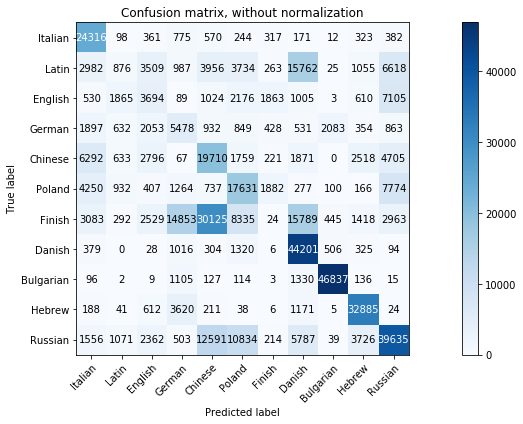

In [41]:
classes = [MAP_CLASS_TO_LANGUAGE[c] for c in sorted(list(set(FEATURES.keys())))]
plot_confusion_matrix(
    None,  # Y_TEST.argmax(axis=1),
    None,  # predictions.argmax(axis=1),
    np.array(classes),
    cm=matrix,
    normalize=False
)

### For sdc long vectors

In [147]:
FEATURE_CLASS_TO_UID = dict(enumerate(set(FEATURES.keys())))
FEATURE_UID_TO_CLASS = dict((v, k) for k, v in FEATURE_CLASS_TO_UID.iteritems())

In [148]:
X, Y = [], []
for i, (c, objs) in enumerate(FEATURES.iteritems()):
    for o in objs:
        X.append(o)
        Y.append(FEATURE_UID_TO_CLASS[c])
print len(X), len(Y)

8907 8907


In [149]:
_X_train_OBJS, X_TEST_OBJS, _y_train_OBJS, Y_TEST_OBJS = train_test_split(X, Y, test_size=0.2)
X_TRAIN_OBJS, X_VAL_OBJS, Y_TRAIN_OBJS, Y_VAL_OBJS = train_test_split(_X_train_OBJS, _y_train_OBJS, test_size=0.2)
print len(X_TRAIN_OBJS), len(X_VAL_OBJS), len(X_TEST_OBJS)
print Counter(Y_TRAIN_OBJS)
print Counter(Y_VAL_OBJS)
print Counter(Y_TEST_OBJS)

5700 1425 1782
Counter({1: 741, 2: 730, 8: 718, 3: 677, 5: 599, 6: 596, 0: 575, 7: 575, 4: 489})
Counter({3: 191, 8: 186, 2: 185, 1: 160, 7: 153, 4: 145, 5: 143, 0: 137, 6: 125})
Counter({2: 255, 1: 224, 3: 214, 8: 203, 6: 192, 5: 184, 4: 175, 7: 171, 0: 164})


In [150]:
def split_into_vectors(_X, _Y):
    X_res, Y_res, File_ID = [], [], []
    for i, (obj, c) in enumerate(zip(_X, _Y)):
        for v in obj.T:
            X_res.append(v)
            Y_res.append(c)
            File_ID.append(i)
    return X_res, Y_res, File_ID

In [151]:
X_TRAIN, Y_TRAIN, _ = split_into_vectors(X_TRAIN_OBJS, Y_TRAIN_OBJS)
X_VAL, Y_VAL, _ = split_into_vectors(X_VAL_OBJS, Y_VAL_OBJS)
X_TEST, Y_TEST, X_TEST_VECTOR_TO_FILE_ID = split_into_vectors(X_TEST_OBJS, Y_TEST_OBJS)
X_TRAIN = np.array(X_TRAIN)
X_TEST = np.array(X_TEST)
X_VAL = np.array(X_VAL)
print len(X_TRAIN), len(X_VAL), len(X_TEST)
print Counter(Y_TRAIN)
print Counter(Y_VAL)
print Counter(Y_TEST)
Y_TRAIN = keras.utils.np_utils.to_categorical(Y_TRAIN)
Y_VAL = keras.utils.np_utils.to_categorical(Y_VAL)
Y_TEST = keras.utils.np_utils.to_categorical(Y_TEST)

1145700 286425 358182
Counter({1: 148941, 2: 146730, 8: 144318, 3: 136077, 5: 120399, 6: 119796, 0: 115575, 7: 115575, 4: 98289})
Counter({3: 38391, 8: 37386, 2: 37185, 1: 32160, 7: 30753, 4: 29145, 5: 28743, 0: 27537, 6: 25125})
Counter({2: 51255, 1: 45024, 3: 43014, 8: 40803, 6: 38592, 5: 36984, 4: 35175, 7: 34371, 0: 32964})


In [152]:
### instantiate model
model = Sequential()

# we can think of this chunk as the input layer
model.add(Dense(128, input_dim=91, init='uniform'))
model.add(BatchNormalization())
model.add(Activation('relu'))

# we can think of this chunk as the hidden layer    
model.add(Dense(100, init='uniform'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))

# we can think of this chunk as the hidden layer    
model.add(Dense(80, init='uniform'))
model.add(BatchNormalization())
model.add(Activation('relu'))

model.add(Dense(64, use_bias=False))
model.add(BatchNormalization())
model.add(Activation('relu'))

model.add(Dense(len(set(Y))))
model.add(Activation('softmax'))
model.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.RMSprop(),
              metrics=['accuracy'])

model.summary()

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:5: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(128, kernel_initializer="uniform", input_dim=91)`
  """
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:10: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(100, kernel_initializer="uniform")`
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:16: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(80, kernel_initializer="uniform")`
  app.launch_new_instance()


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_41 (Dense)             (None, 128)               11776     
_________________________________________________________________
batch_normalization_33 (Batc (None, 128)               512       
_________________________________________________________________
activation_41 (Activation)   (None, 128)               0         
_________________________________________________________________
dense_42 (Dense)             (None, 100)               12900     
_________________________________________________________________
batch_normalization_34 (Batc (None, 100)               400       
_________________________________________________________________
activation_42 (Activation)   (None, 100)               0         
_________________________________________________________________
dropout_9 (Dropout)          (None, 100)               0         
__________

In [153]:
# running the fitting
model.fit(
    X_TRAIN,
    Y_TRAIN,
    validation_data=(X_VAL, Y_VAL),
    nb_epoch=4,
    batch_size=64,
    verbose=1
)

Train on 1145700 samples, validate on 286425 samples
Epoch 1/4
1145700/1145700 [==============================] - 83s 73us/step - loss: 1.4348 - acc: 0.4901 - val_loss: 1.1340 - val_acc: 0.6080
Epoch 2/4
1145700/1145700 [==============================] - 83s 72us/step - loss: 1.2060 - acc: 0.5799 - val_loss: 1.0562 - val_acc: 0.6356
Epoch 3/4
1145700/1145700 [==============================] - 83s 72us/step - loss: 1.1526 - acc: 0.5995 - val_loss: 1.0176 - val_acc: 0.6493
Epoch 4/4
1145700/1145700 [==============================] - 83s 72us/step - loss: 1.1248 - acc: 0.6101 - val_loss: 0.9878 - val_acc: 0.6608


In [155]:
# model.save('/home/kolegor/Study/Master/Work/results/05__9_lang__only_sdc(cutted_prev_with_mfcc)/model.keras')

In [337]:
model = load_model('/home/kolegor/model_9.keras')

#### score by little vectors separately

In [338]:
score = model.evaluate(X_TEST, Y_TEST)
score

476247/476247 [==============================] - 37s 77us/step


[1.8438372296310308, 0.64401245572213162]

In [339]:
predictions = model.predict(X_TEST)
matrix = metrics.confusion_matrix(Y_TEST.argmax(axis=1), predictions.argmax(axis=1))
matrix

array([[36226,   464,  3610,   458,    42,   121,   220,    15,    55],
       [ 2024, 42935, 10288,   124,  6999,  5255,  3501, 12290,    92],
       [12539,   122,  2122,     1, 28969,   216,    43,   266,    11],
       [   22,   983,   198, 46665,   515,   397,   654,   523,   659],
       [ 7287,  8574,  2788,   378, 22143,   235,   900,   824,  3554],
       [   61,  1235,   488,    92,   294, 86955,   709,   748,   219],
       [17994, 14755,  1969,  1158,   309,   477, 29403,  3930,  1666],
       [  152,  2014,     1,   353,    14,     0,  2672, 16848,    86],
       [    7,   376,   205,   334,   170,   178,   544,   112, 23412]])

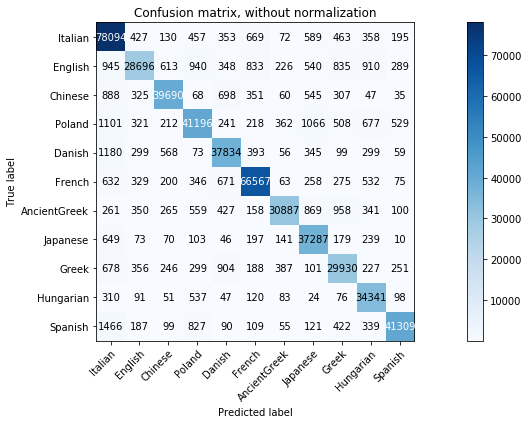

In [123]:
classes = [MAP_CLASS_TO_LANGUAGE[c] for c in sorted(list(set(FEATURES.keys())))]
plot_confusion_matrix(
    None,  # Y_TEST.argmax(axis=1),
    None,  # predictions.argmax(axis=1),
    np.array(classes),
    cm=matrix,
    normalize=False
)

#### score grouped by file_id

In [340]:
predictions_by_file_id = defaultdict(list)
real_by_file_id = dict()
classes = set()
for x, file_id, pred, real in zip(X_TEST, X_TEST_VECTOR_TO_FILE_ID, predictions, Y_TEST):
    predictions_by_file_id[file_id].append(pred)
    real_class = np.argmax(real)
    if file_id in real_by_file_id and real_by_file_id[file_id] != real_class:
        raise Exception('!!!')
    real_by_file_id[file_id] = real_class
    classes.add(MAP_CLASS_TO_LANGUAGE[real_class])

In [342]:
confusion_matrix = np.zeros((len(classes), len(classes)))
overall_count, overall_true = 0, 0
for file_id, file_predictions in predictions_by_file_id.iteritems():
    real_class = real_by_file_id[file_id]
    
    pred_class = None
    
    # 1 - Max sure over all vectors
    if False:
        _max_sure = -1
        _max_sure_class = None
        for p in file_predictions:
            if max(p) > _max_sure:
                _max_sure = max(p)
                _max_sure_class = np.argmax(p)
        pred_class = _max_sure_class
    
    # 2 - Max count over all vectors
    else:
        counter = Counter()
        for p in file_predictions:
            counter[np.argmax(p)] += 1
        pred_class = counter.most_common(1)[0][0]
    
    overall_count += 1
    if real_class == pred_class:
        overall_true += 1

    confusion_matrix[real_class][pred_class] += 1

print float(overall_true) / overall_count
confusion_matrix = confusion_matrix.astype(int)
print confusion_matrix

0.729778745013
[[240   0   0   1   0   0   0   0   0]
 [  0 257  71   0  35  12   2 101   0]
 [ 26   0   0   0 233   0   0   0   0]
 [  0   0   0 295   0   1   0   0   0]
 [ 18  22   0   0 232   0   0   1   0]
 [  0   0   0   0   0 531   0   0   0]
 [ 71 146   1   0   0   0 192   1   0]
 [  0   0   0   0   0   0   3 117   0]
 [  0   0   0   0   0   0   0   0 148]]


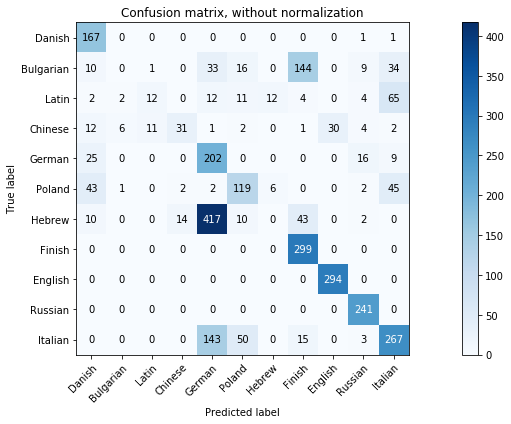

In [57]:
plot_confusion_matrix(
    None,
    None,
    np.array(list(classes)),
    cm=confusion_matrix,
    normalize=False
)

In [60]:
# model.save('/home/kolegor/Study/Master/Work/results/08__11_lang__full_features__silence_remove__by_separate_speakers/model.keras')

### Parameters for dense

In [59]:
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import GridSearchCV

In [60]:
def get_result_by_file_id(_X_TEST, _X_TEST_FILE_ID, _PREDICTIONS, _Y_TEST):
    predictions_by_file_id = defaultdict(list)
    real_by_file_id = dict()
    classes = set()

    for x, file_id, pred, real in zip(_X_TEST, _X_TEST_FILE_ID, _PREDICTIONS, Y_TEST):
        predictions_by_file_id[file_id].append(pred)
        real_class = np.argmax(real)
        if file_id in real_by_file_id and real_by_file_id[file_id] != real_class:
            raise Exception('!!!')
        real_by_file_id[file_id] = real_class
        classes.add(MAP_CLASS_TO_LANGUAGE[real_class])
    
    confusion_matrix = np.zeros((len(classes), len(classes)))
    overall_count, overall_true = 0, 0
    for file_id, file_predictions in predictions_by_file_id.iteritems():
        real_class = real_by_file_id[file_id]

        pred_class = None

        # 1 - Max sure over all vectors
        if True:
            _max_sure = -1
            _max_sure_class = None
            for p in file_predictions:
                if max(p) > _max_sure:
                    _max_sure = max(p)
                    _max_sure_class = np.argmax(p)
            pred_class = _max_sure_class

        # 2 - Max count over all vectors
        else:
            counter = Counter()
            for p in file_predictions:
                counter[np.argmax(p)] += 1
            pred_class = counter.most_common(1)[0][0]

        overall_count += 1
        if real_class == pred_class:
            overall_true += 1

        confusion_matrix[real_class][pred_class] += 1

    confusion_matrix = confusion_matrix.astype(int)
    return (float(overall_true) / overall_count), confusion_matrix

In [61]:
INPUT_DIM = X_TRAIN.shape[1]
NUMBER_OF_CLASSES = len(set(FEATURES.keys()))
print INPUT_DIM, NUMBER_OF_CLASSES

234 9


In [76]:
def create_model(learning_rate=None, dropout_rate=None, optimizer_name=None, **kwargs):
    ### instantiate model
    model = Sequential()

    # we can think of this chunk as the input layer
    model.add(Dense(128, input_dim=INPUT_DIM, init='uniform'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))

    # we can think of this chunk as the hidden layer    
    model.add(Dense(100, init='uniform'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Dropout(dropout_rate))

    # we can think of this chunk as the hidden layer    
    model.add(Dense(80, init='uniform'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))

    model.add(Dense(64, use_bias=False))
    model.add(BatchNormalization())
    model.add(Activation('relu'))

    model.add(Dense(NUMBER_OF_CLASSES))
    model.add(Activation('softmax'))
    
    if optimizer_name == 'sgd':
        optimizer = keras.optimizers.SGD(lr=learning_rate)
    elif optimizer_name == 'rmsprop':
        optimizer = keras.optimizers.RMSprop(lr=learning_rate)
    elif optimizer_name == 'adam':
        optimizer = keras.optimizers.Adam(lr=learning_rate)
        
    model.compile(loss=keras.losses.categorical_crossentropy,
                  optimizer=optimizer,  # keras.optimizers.RMSprop(),
                  metrics=['accuracy'])

    return model

In [77]:
param_grid = {
    'learning_rate': [0.0001, 0.001, 0.005, 0.01],
    'dropout_rate': [0.1, 0.25, 0.5],
    'optimizer_name': [
        'sgd', 'rmsprop', 'adam'
    ]
}
keys = sorted(param_grid.keys())
all_values = [param_grid[k] for k in keys]
all_combinations = list(itertools.product(*all_values))
print len(all_combinations)

36


In [78]:
from datetime import datetime

In [102]:
all_results = []
for i, params in enumerate(all_combinations[:2]):
    kwargs = dict(zip(keys, params))
    print '\n\n', i, len(all_combinations), kwargs
    
    model = create_model(**kwargs)
    
    print 'Fitting...', datetime.now()
    h = model.fit(
        X_TRAIN,
        Y_TRAIN,
        validation_data=(X_VAL, Y_VAL),
        nb_epoch=4,
        batch_size=64,
        verbose=1
    )

    print 'Saving...', datetime.now()
    model.save('/home/kolegor/model_{}.keras'.format(i))
    
    print 'Evaluating...', datetime.now()
    predictions = model.predict(X_TEST)
    acc, conf_m = get_result_by_file_id(X_TEST, X_TEST_VECTOR_TO_FILE_ID, predictions, Y_TEST)
    acc2 = model.evaluate(X_TEST, Y_TEST)
    print acc, acc2
    
    all_results.append((kwargs, model, h, acc, acc2, conf_m))



0 36 {'dropout_rate': 0.1, 'learning_rate': 0.0001, 'optimizer_name': 'sgd'}


/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:6: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(128, kernel_initializer="uniform", input_dim=234)`
  
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:11: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(100, kernel_initializer="uniform")`
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:17: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(80, kernel_initializer="uniform")`


Fitting... 2019-03-17 11:17:15.054011
Train on 1960971 samples, validate on 266742 samples
Epoch 1/4
1960971/1960971 [==============================] - 327s 167us/step - loss: 1.6177 - acc: 0.4328 - val_loss: 1.6552 - val_acc: 0.4871
Epoch 2/4
1960971/1960971 [==============================] - 193s 98us/step - loss: 1.1539 - acc: 0.6181 - val_loss: 1.5468 - val_acc: 0.5260
Epoch 3/4
1960971/1960971 [==============================] - 195s 100us/step - loss: 0.9365 - acc: 0.6934 - val_loss: 1.4538 - val_acc: 0.5549
Epoch 4/4
1960971/1960971 [==============================] - 192s 98us/step - loss: 0.8052 - acc: 0.7369 - val_loss: 1.4044 - val_acc: 0.5793
Saving... 2019-03-17 11:32:23.441757
Evaluating... 2019-03-17 11:32:28.086103
476247/476247 [==============================] - 41s 86us/step
0.589771490751 [1.5876434002216431, 0.52292402891689138]


1 36 {'dropout_rate': 0.1, 'learning_rate': 0.0001, 'optimizer_name': 'rmsprop'}
Fitting... 2019-03-17 11:33:55.016690
Train on 1960971 sam

In [105]:
# with open('/home/kolegor/gs.results.json', 'w') as outf:
#     pickle.dump(all_results_without_modules, outf)
# with open('/home/kolegor/gs.results.json', 'r') as inf:
#     all_results = pickle.load(inf)

In [266]:
def parse_one_raw_experiment(chunk):
    lines = filter(None, chunk.split('\n'))
    kwargs = eval(u' '.join(lines[0].split(' ')[2:]))
    
    tokens = lines[10].split('-')
    train_score = float(tokens[-3].split(':')[-1].strip())
    val_score = (tokens[-1].split(':')[-1].strip())
    
    tokens = lines[-1].split(' ')
    test_2_score = float(tokens[0])
    test_score = float(tokens[2][:-1])

    return (kwargs, train_score, val_score, test_score, test_2_score)

def parse_experiments_from_raw_log(log_file):
    results = []
    with open(log_file, 'r') as inf:
        all_data = inf.read()
        chunks = filter(None, all_data.split('\n\n'))
        for chunk in chunks:
            results.append(parse_one_raw_experiment(chunk))
    return results

In [267]:
all_results = parse_experiments_from_raw_log('/home/kolegor/Study/Master/Work/data/gridsearch_results.txt')

In [310]:
def plot_heat_map(ax, matrix, x_ticks, y_ticks, title=None, x_label=None, y_label=None, threshold=0.67):
    im = ax.imshow(matrix)

    ax.set_xticks(np.arange(len(x_ticks)))
    ax.set_yticks(np.arange(len(y_ticks)))
    ax.set_xticklabels(x_ticks)
    ax.set_yticklabels(y_ticks)

    for i in range(len(y_ticks)):
        for j in range(len(x_ticks)):
            color = 'w' if matrix[i, j] < threshold else 'black'
            text = ax.text(j, i, matrix[i, j], ha="center", va="center", color=color)

    ax.set_title(title)
    if x_label:
        ax.set_xlabel(x_label)
    if y_label:
        ax.set_ylabel(y_label)
    
    return im

In [330]:
def plot_heat_map_for_one_stat(stat_name_to_use):
    fig, axes = plt.subplots(figsize=(15, 6), nrows=1, ncols=3)
    for i, optimizer_name in enumerate(param_grid['optimizer_name']):
        all_lr = param_grid['learning_rate']
        all_dr = param_grid['dropout_rate']
        lr_to_pos = dict(zip(all_lr, xrange(len(all_lr))))
        dr_to_pos = dict(zip(all_dr, xrange(len(all_dr))))

        results = [[-100 for _ in xrange(len(all_lr))] for _ in xrange(len(all_dr))]
        all_values = []

        for res in all_results:
            kwargs, train_score, val_score, test_score, test_2_score = res
            if kwargs['optimizer_name'] == optimizer_name:
                use_value = float(u'{:.4f}'.format(float(eval(stat_name_to_use))))
                all_values.append(use_value)
                results[dr_to_pos[kwargs['dropout_rate']]][lr_to_pos[kwargs['learning_rate']]] = use_value

        im = plot_heat_map(
            axes[i],
            np.array(results), all_lr, all_dr,
            title=u'{} ({})'.format(optimizer_name, stat_name_to_use),
            x_label='learning rage',
            y_label='dropout rate' if i == 0 else None,
            threshold=sorted(all_values)[5]
        )

        from mpl_toolkits.axes_grid1 import make_axes_locatable
        divider = make_axes_locatable(axes[i])
        cax = divider.append_axes('right', size='5%', pad=0.15)
        fig.colorbar(im, cax=cax, orientation='vertical')

    # plt.colorbar()
    fig.tight_layout()
    plt.show()

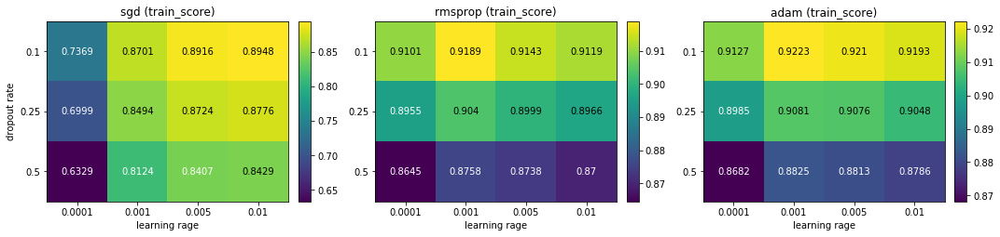

In [332]:
plot_heat_map_for_one_stat('train_score')

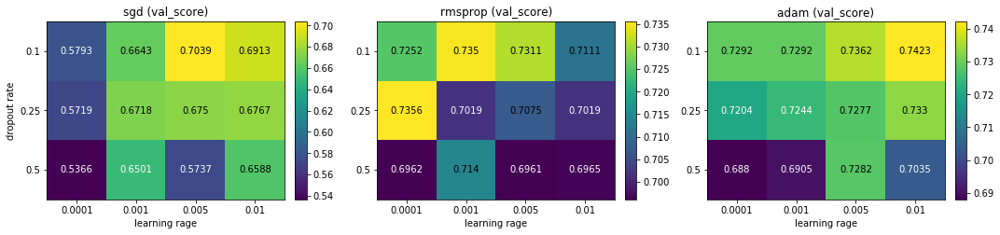

In [333]:
plot_heat_map_for_one_stat('val_score')

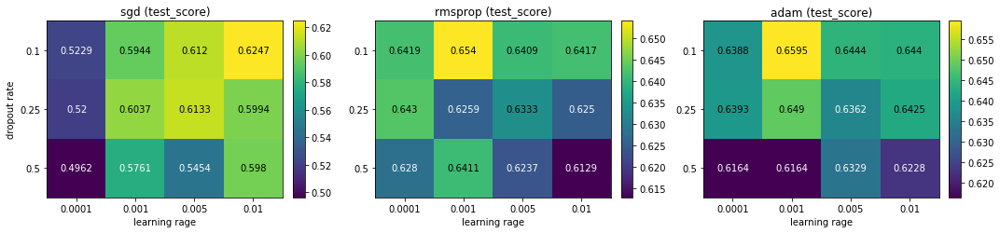

In [334]:
plot_heat_map_for_one_stat('test_score')

### Conv for images

In [14]:
X_TRAIN, Y_TRAIN, X_TEST, Y_TEST = [], [], [], []
TEST_SIZE = 0.3

for c, objs in FEATURES.iteritems():
    test_count = int(len(objs) * TEST_SIZE)
    for i, obj in enumerate(objs):
        if obj.shape != shape:
            continue
        if i < test_count:
            X_TEST.append(obj)
            Y_TEST.append(c)
        else:
            X_TRAIN.append(obj)
            Y_TRAIN.append(c)

print Counter(Y_TRAIN)
print Counter(Y_TEST)
print X_TRAIN[1].shape

Counter({1: 1734, 10: 1581, 6: 1515, 9: 1442, 0: 1406, 8: 1366, 3: 918, 5: 819, 4: 788, 7: 758, 2: 614})
Counter({1: 742, 10: 677, 6: 648, 9: 618, 0: 602, 8: 585, 3: 393, 5: 351, 4: 337, 7: 324, 2: 262})
(130, 201)


In [15]:
batch_size = 128
num_classes = len(set(FEATURES.keys()))
droprate = 0.25
input_shape = (130, 201, 1)

model = Sequential()

model.add(Conv2D(128, kernel_size=(2, 2), padding="same", activation='relu', input_shape=input_shape))
model.add(BatchNormalization())

model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', border_mode="same"))
model.add(BatchNormalization())
model.add(MaxPooling2D())
model.add(Dropout(droprate))

model.add(Conv2D(64, kernel_size=(2, 2), activation='relu', border_mode="same"))
model.add(BatchNormalization())
model.add(MaxPooling2D())

model.add(Conv2D(32, kernel_size=(2, 2), activation='relu', border_mode="same"))
model.add(BatchNormalization())
model.add(MaxPooling2D())

model.add(Flatten())
model.add(Dense(256, use_bias=False))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(droprate))
model.add(Dense(128, use_bias=False))
model.add(BatchNormalization())
model.add(Activation('relu'))

model.add(Dense(num_classes))
model.add(Activation('softmax'))
model.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.RMSprop(),
              metrics=['accuracy'])

model.summary()

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:11: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, padding="same", activation="relu", kernel_size=(3, 3))`
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:16: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, padding="same", activation="relu", kernel_size=(2, 2))`
  app.launch_new_instance()
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:20: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(32, padding="same", activation="relu", kernel_size=(2, 2))`


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 130, 201, 128)     640       
_________________________________________________________________
batch_normalization_1 (Batch (None, 130, 201, 128)     512       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 130, 201, 64)      73792     
_________________________________________________________________
batch_normalization_2 (Batch (None, 130, 201, 64)      256       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 65, 100, 64)       0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 65, 100, 64)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 65, 100, 64)       16448     
__________

In [16]:
X_TRAIN_ARRAY = np.array(X_TRAIN)
X_TRAIN_ARRAY = np.expand_dims(X_TRAIN_ARRAY, axis=3)
Y_TRAIN_ARRAY = keras.utils.np_utils.to_categorical(Y_TRAIN)

In [17]:
history = model.fit(
    X_TRAIN_ARRAY,
    Y_TRAIN_ARRAY,
    batch_size=batch_size,
    epochs=3,
    verbose=1,
    # validation_data=(X_test_CNN, y_test_CNN),
    shuffle=True,
    # callbacks=callbacks
)

Epoch 1/3
12941/12941 [==============================] - 8822s 682ms/step - loss: 0.7529 - acc: 0.7786
Epoch 2/3
12941/12941 [==============================] - 8825s 682ms/step - loss: 0.1484 - acc: 0.9628
Epoch 3/3
12941/12941 [==============================] - 8930s 690ms/step - loss: 0.0613 - acc: 0.9866


In [19]:
model.save('/home/kolegor/keras_mfcc_sdc_10_lang.keras')

In [20]:
X_TEST_ARRAY = np.array(X_TEST)
X_TEST_ARRAY = np.expand_dims(X_TEST_ARRAY, axis=3)
Y_TEST_ARRAY = keras.utils.np_utils.to_categorical(Y_TEST)

In [30]:
score = model.evaluate(X_TEST_ARRAY, Y_TEST_ARRAY)
score

5539/5539 [==============================] - 1282s 231ms/step


[0.55331473271494469, 0.82596136486730454]

### Confusion matrix

In [21]:
predictions = model.predict(X_TEST_ARRAY)

In [22]:
matrix = metrics.confusion_matrix(Y_TEST_ARRAY.argmax(axis=1), predictions.argmax(axis=1))
matrix

array([[548,   6,   2,   0,   1,   2,   2,   0,   0,   0,  41],
       [  0, 708,   0,   0,   2,   5,   2,   0,   0,   0,  25],
       [  0,  17, 149,   0,   5,   8,   1,   0,   0,   0,  82],
       [  1,   8,  31, 170,  49,  24,   4,   0,   8,   8,  90],
       [  1,   2,   2,   0, 327,   2,   0,   0,   0,   0,   3],
       [  1,   6,   2,   0,   7, 260,   2,   0,   0,   0,  73],
       [  1,  93,   2,   0,  33,   2, 478,   0,   0,   3,  36],
       [  3,  58,  41,   1,  95,   0,   0,  85,   1,  16,  24],
       [  2,   0,   0,   0,   0,   4,   0,   0, 572,   0,   7],
       [  2,   0,   0,   0,   0,   0,   0,   0,   0, 616,   0],
       [  0,   1,   3,   0,   0,  11,   0,   0,   0,   0, 662]])

In [28]:
def plot_confusion_matrix(y_true, y_pred, classes, normalize=False, title=None, cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    classes = classes[unique_labels(y_true, y_pred)]
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    fig, ax = plt.subplots(figsize=(15, 6))
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

In [29]:
# classes = [MAP_CLASS_TO_LANGUAGE[c] for c in sorted(list(set(FEATURES.keys())))]
# plot_confusion_matrix(
#     Y_TEST_ARRAY.argmax(axis=1),
#     predictions.argmax(axis=1),
#     np.array(classes),
#     normalize=False
# )

### Visualizing

In [17]:
FEATURES[0][0].shape

(141, 201)

In [17]:
model = keras.models.load_model('/home/kolegor/Study/Master/Work/results/02__10_lang__with_rus_and_eng__3_epochs/keras2attempt.keras')

#### https://www.analyticsvidhya.com/blog/2018/03/essentials-of-deep-learning-visualizing-convolutional-neural-networks/
#### Smth long and unknown

In [18]:
from vis.visualization import visualize_activation
from vis.utils import utils
from keras import activations

from matplotlib import pyplot as plt
%matplotlib inline
plt.rcParams['figure.figsize'] = (18, 6)

# # Utility to search for layer index by name.
# # Alternatively we can specify this as -1 since it corresponds to the last layer.
# layer_idx = -1  # utils.find_layer_idx(model, 'preds')

# # Swap softmax with linear
# model.layers[layer_idx].activation = activations.linear
# model = utils.apply_modifications(model)

# # This is the output node we want to maximize.
# filter_idx = 0
# img = visualize_activation(model, layer_idx, filter_indices=filter_idx)
# plt.imshow(img[..., 0])

In [20]:
def iter_occlusion(image, size=8):
    # taken from https://www.kaggle.com/blargl/simple-occlusion-and-saliency-maps

    occlusion = np.full((size * 5, size * 5), [0.5], np.float32)
    occlusion_center = np.full((size, size), [0.5], np.float32)
    occlusion_padding = size * 2

    # print('padding...')
    image_padded = np.pad(
        image,
        ((occlusion_padding, occlusion_padding), (occlusion_padding, occlusion_padding)),
        'constant',
        constant_values = 0.0
    )

    for y in range(occlusion_padding, image.shape[0] + occlusion_padding, size):
        for x in range(occlusion_padding, image.shape[1] + occlusion_padding, size):
            try:
                tmp = image_padded.copy()

                tmp[y - occlusion_padding:y + occlusion_center.shape[0] + occlusion_padding, \
                 x - occlusion_padding:x + occlusion_center.shape[1] + occlusion_padding] \
                 = occlusion

                tmp[y:y + occlusion_center.shape[0], x:x + occlusion_center.shape[1]] = occlusion_center

                yield x - occlusion_padding, y - occlusion_padding, \
                 tmp[occlusion_padding:tmp.shape[0] - occlusion_padding, occlusion_padding:tmp.shape[1] - occlusion_padding]
            except:
                print y, x
                continue

### Occlusion

In [28]:
TEST_X = FEATURES[7][2]
TEST_Y = 7

inp = TEST_X.reshape(1, 141, 201, 1)  # input tensor for model.predict
img = TEST_X.reshape(141, 201)  # image data for matplotlib's imshow

img_size = img.shape[0]
occl_size = 8
heatmap = np.zeros((img_size, img_size), np.float32)
class_pixels = np.zeros((img_size, img_size), np.int16)

counters = defaultdict(int)
for n, (x, y, img_float) in enumerate(iter_occlusion(TEST_X, size=occl_size)):
    X = img_float.reshape(1, 141, 201, 1)
    out = model.predict(X)
    print('#{}: {} @ {} (correct class: {})'.format(n, np.argmax(out), np.amax(out), out[0][TEST_Y]))
    print('x {} - {} | y {} - {}'.format(x, x + occl_size, y, y + occl_size))

    heatmap[y:y + occl_size, x:x + occl_size] = out[0][TEST_Y]
    class_pixels[y:y + occl_size, x:x + occl_size] = np.argmax(out)
    counters[np.argmax(out)] += 1


pred = model.predict(inp)
print('Correct class: {}'.format(TEST_Y))
print('Predicted class: {} (prob: {})'.format(np.argmax(pred), np.amax(out)))

print('Predictions:')
for class_id, count in counters.items():
    print('{}: {}'.format(class_id, count))

#0: 7 @ 0.97129201889 (correct class: 0.97129201889)
x 0 - 8 | y 0 - 8
#1: 7 @ 0.981857001781 (correct class: 0.981857001781)
x 8 - 16 | y 0 - 8
#2: 7 @ 0.984795153141 (correct class: 0.984795153141)
x 16 - 24 | y 0 - 8
#3: 7 @ 0.986352801323 (correct class: 0.986352801323)
x 24 - 32 | y 0 - 8
#4: 7 @ 0.992870986462 (correct class: 0.992870986462)
x 32 - 40 | y 0 - 8
#5: 7 @ 0.996403098106 (correct class: 0.996403098106)
x 40 - 48 | y 0 - 8
#6: 7 @ 0.996351003647 (correct class: 0.996351003647)
x 48 - 56 | y 0 - 8
#7: 7 @ 0.995538175106 (correct class: 0.995538175106)
x 56 - 64 | y 0 - 8
#8: 7 @ 0.993801653385 (correct class: 0.993801653385)
x 64 - 72 | y 0 - 8
#9: 7 @ 0.982985198498 (correct class: 0.982985198498)
x 72 - 80 | y 0 - 8
#10: 7 @ 0.956472933292 (correct class: 0.956472933292)
x 80 - 88 | y 0 - 8
#11: 7 @ 0.906580924988 (correct class: 0.906580924988)
x 88 - 96 | y 0 - 8
#12: 7 @ 0.916112542152 (correct class: 0.916112542152)
x 96 - 104 | y 0 - 8
#13: 7 @ 0.939518034458 (c

#105: 7 @ 0.969353497028 (correct class: 0.969353497028)
x 40 - 48 | y 32 - 40
#106: 7 @ 0.967126071453 (correct class: 0.967126071453)
x 48 - 56 | y 32 - 40
#107: 7 @ 0.956884801388 (correct class: 0.956884801388)
x 56 - 64 | y 32 - 40
#108: 7 @ 0.967145502567 (correct class: 0.967145502567)
x 64 - 72 | y 32 - 40
#109: 7 @ 0.976818680763 (correct class: 0.976818680763)
x 72 - 80 | y 32 - 40
#110: 7 @ 0.974361777306 (correct class: 0.974361777306)
x 80 - 88 | y 32 - 40
#111: 7 @ 0.935207664967 (correct class: 0.935207664967)
x 88 - 96 | y 32 - 40
#112: 7 @ 0.941818714142 (correct class: 0.941818714142)
x 96 - 104 | y 32 - 40
#113: 7 @ 0.950042665005 (correct class: 0.950042665005)
x 104 - 112 | y 32 - 40
#114: 7 @ 0.930279254913 (correct class: 0.930279254913)
x 112 - 120 | y 32 - 40
#115: 7 @ 0.891151607037 (correct class: 0.891151607037)
x 120 - 128 | y 32 - 40
#116: 7 @ 0.898496925831 (correct class: 0.898496925831)
x 128 - 136 | y 32 - 40
#117: 7 @ 0.915104866028 (correct class: 0.

#208: 7 @ 0.952368557453 (correct class: 0.952368557453)
x 64 - 72 | y 64 - 72
#209: 7 @ 0.971040248871 (correct class: 0.971040248871)
x 72 - 80 | y 64 - 72
#210: 7 @ 0.966953098774 (correct class: 0.966953098774)
x 80 - 88 | y 64 - 72
#211: 7 @ 0.894154787064 (correct class: 0.894154787064)
x 88 - 96 | y 64 - 72
#212: 7 @ 0.870695412159 (correct class: 0.870695412159)
x 96 - 104 | y 64 - 72
#213: 7 @ 0.906804084778 (correct class: 0.906804084778)
x 104 - 112 | y 64 - 72
#214: 7 @ 0.926407396793 (correct class: 0.926407396793)
x 112 - 120 | y 64 - 72
#215: 7 @ 0.92071557045 (correct class: 0.92071557045)
x 120 - 128 | y 64 - 72
#216: 7 @ 0.927674889565 (correct class: 0.927674889565)
x 128 - 136 | y 64 - 72
#217: 7 @ 0.953037261963 (correct class: 0.953037261963)
x 136 - 144 | y 64 - 72
#218: 7 @ 0.954304873943 (correct class: 0.954304873943)
x 144 - 152 | y 64 - 72
#219: 7 @ 0.932928979397 (correct class: 0.932928979397)
x 152 - 160 | y 64 - 72
#220: 7 @ 0.942060112953 (correct class

#311: 7 @ 0.969944655895 (correct class: 0.969944655895)
x 88 - 96 | y 96 - 104
#312: 7 @ 0.959501743317 (correct class: 0.959501743317)
x 96 - 104 | y 96 - 104
#313: 7 @ 0.965923607349 (correct class: 0.965923607349)
x 104 - 112 | y 96 - 104
#314: 7 @ 0.970303237438 (correct class: 0.970303237438)
x 112 - 120 | y 96 - 104
#315: 7 @ 0.976182460785 (correct class: 0.976182460785)
x 120 - 128 | y 96 - 104
#316: 7 @ 0.970542192459 (correct class: 0.970542192459)
x 128 - 136 | y 96 - 104
#317: 7 @ 0.969790935516 (correct class: 0.969790935516)
x 136 - 144 | y 96 - 104
#318: 7 @ 0.977399349213 (correct class: 0.977399349213)
x 144 - 152 | y 96 - 104
#319: 7 @ 0.963125228882 (correct class: 0.963125228882)
x 152 - 160 | y 96 - 104
#320: 7 @ 0.970827758312 (correct class: 0.970827758312)
x 160 - 168 | y 96 - 104
#321: 7 @ 0.954704642296 (correct class: 0.954704642296)
x 168 - 176 | y 96 - 104
#322: 7 @ 0.946378290653 (correct class: 0.946378290653)
x 176 - 184 | y 96 - 104
#323: 7 @ 0.9578643

#412: 7 @ 0.878460407257 (correct class: 0.878460407257)
x 96 - 104 | y 128 - 136
#413: 7 @ 0.898462831974 (correct class: 0.898462831974)
x 104 - 112 | y 128 - 136
#414: 7 @ 0.910169005394 (correct class: 0.910169005394)
x 112 - 120 | y 128 - 136
#415: 7 @ 0.920577526093 (correct class: 0.920577526093)
x 120 - 128 | y 128 - 136
#416: 7 @ 0.873608112335 (correct class: 0.873608112335)
x 128 - 136 | y 128 - 136
#417: 7 @ 0.887607514858 (correct class: 0.887607514858)
x 136 - 144 | y 128 - 136
#418: 7 @ 0.852432549 (correct class: 0.852432549)
x 144 - 152 | y 128 - 136
#419: 7 @ 0.838949799538 (correct class: 0.838949799538)
x 152 - 160 | y 128 - 136
#420: 7 @ 0.799031794071 (correct class: 0.799031794071)
x 160 - 168 | y 128 - 136
#421: 7 @ 0.820351481438 (correct class: 0.820351481438)
x 168 - 176 | y 128 - 136
#422: 7 @ 0.821255087852 (correct class: 0.821255087852)
x 176 - 184 | y 128 - 136
#423: 7 @ 0.86762714386 (correct class: 0.86762714386)
x 184 - 192 | y 128 - 136
#424: 7 @ 0.9

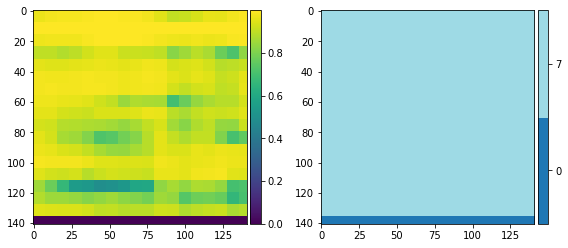

In [29]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import BoundaryNorm
from matplotlib.colorbar import ColorbarBase
from matplotlib import cm

fig = plt.figure(figsize=(8, 8))

ax1 = plt.subplot(1, 2, 1, aspect='equal')
hm = ax1.imshow(heatmap)

ax2 = plt.subplot(1, 2, 2, aspect='equal')


vals = np.unique(class_pixels).tolist()
bounds = vals + [vals[-1] + 1]  # add an extra item for cosmetic reasons

custom = cm.get_cmap('Vega20', len(bounds)) # discrete colors

norm = BoundaryNorm(bounds, custom.N)

cp = ax2.imshow(class_pixels, norm=norm, cmap=custom)

divider = make_axes_locatable(ax1)
cax1 = divider.append_axes("right", size="5%", pad=0.05)
cbar1 = plt.colorbar(hm, cax=cax1)

divider = make_axes_locatable(ax2)
cax2 = divider.append_axes("right", size="5%", pad=0.05)
cbar2 = ColorbarBase(cax2, cmap=custom, norm=norm,
                         # place the ticks at the average value between two entries
                         # e.g. [280, 300] -> 290
                         # so that they're centered on the colorbar
                         ticks=[(a + b) / 2.0 for a, b in zip(bounds[::], bounds[1::])],
                         boundaries=bounds, spacing='uniform', orientation='vertical')

cbar2.ax.set_yticklabels([n for n in np.unique(class_pixels)])

fig.tight_layout()

In [87]:
print MAP_CLASS_TO_LANGUAGE[0], MAP_CLASS_TO_LANGUAGE[2], MAP_CLASS_TO_LANGUAGE[7]

Italian English Danish


### Saliency

In [38]:
# from matplotlib import pyplot as plt
# %matplotlib inline
# plt.rcParams['figure.figsize'] = (18, 6)
# plt.imshow(TEST_X)

In [22]:
from vis.visualization import visualize_saliency
from vis.utils import utils
from keras import activations

# Utility to search for layer index by name. 
# Alternatively we can specify this as -1 since it corresponds to the last layer.
layer_idx = -1  # utils.find_layer_idx(model, 'preds')

# Swap softmax with linear
model.layers[layer_idx].activation = activations.linear
model = utils.apply_modifications(model)

grads = visualize_saliency(model, layer_idx, filter_indices=class_idx, seed_input=TEST_X.reshape(141, 201, 1))
# Plot with 'jet' colormap to visualize as a heatmap.
plt.imshow(grads, cmap='jet')

NameError: name 'TEST_X' is not defined

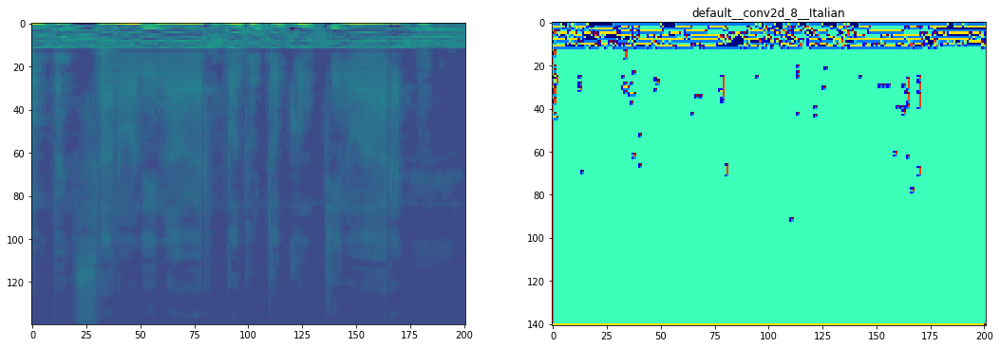

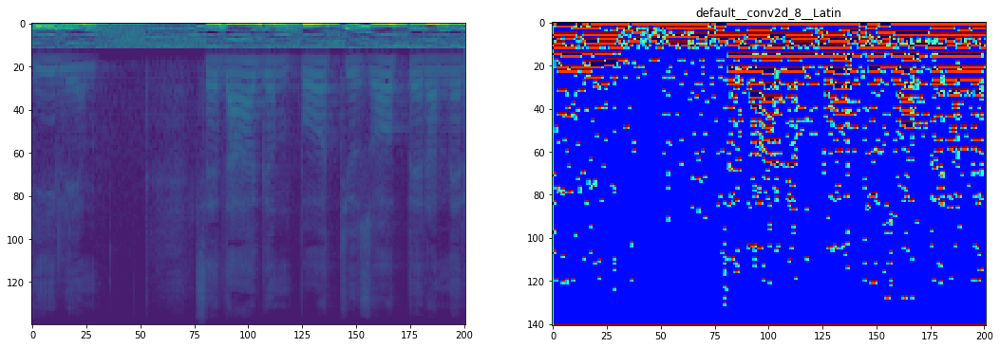

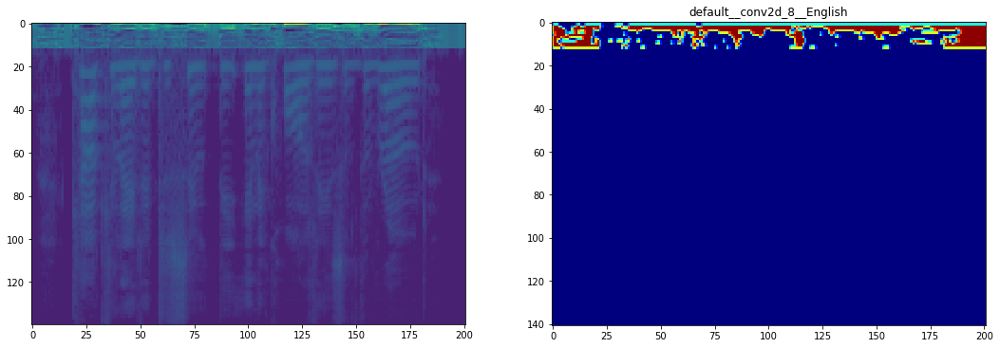

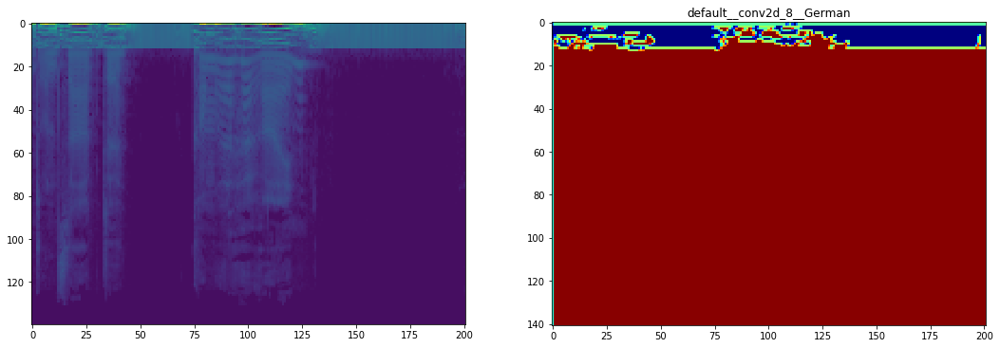

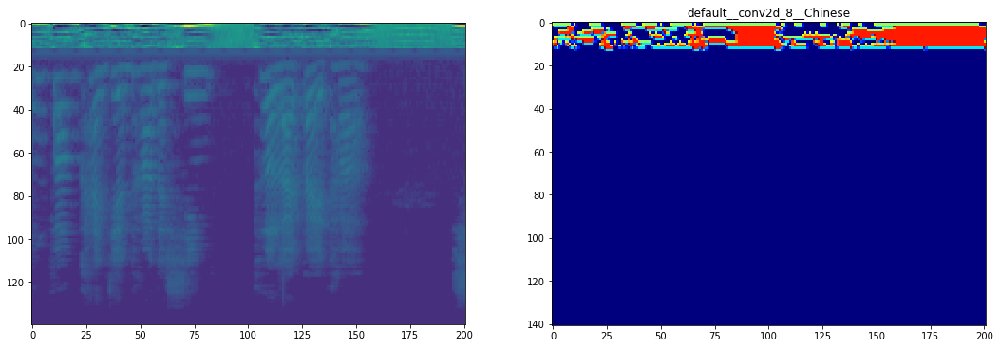

...

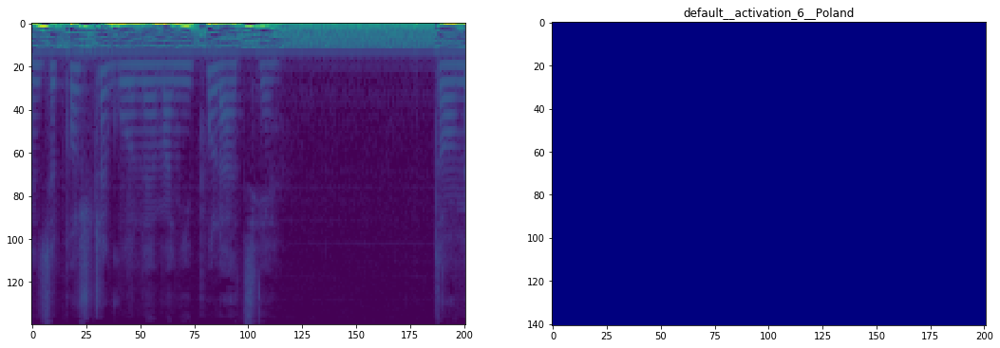

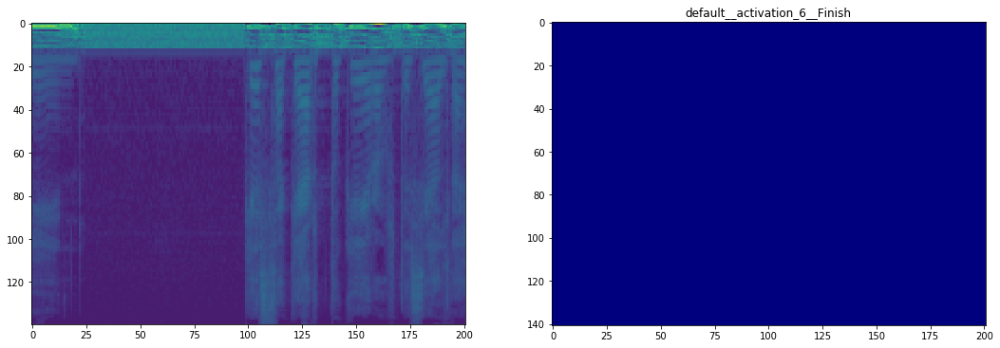

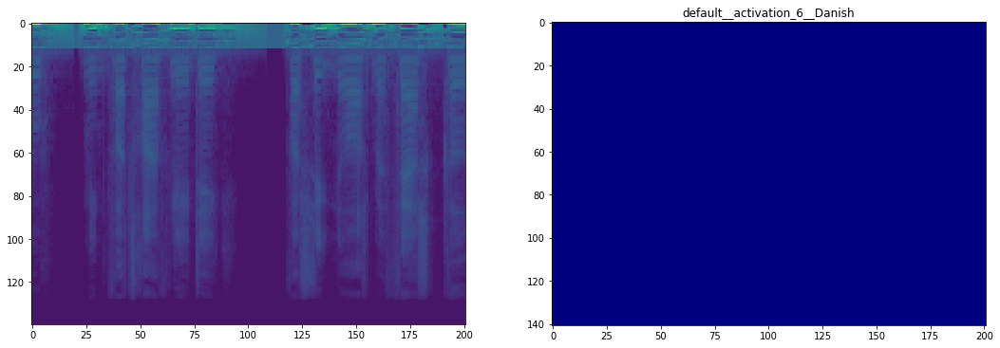

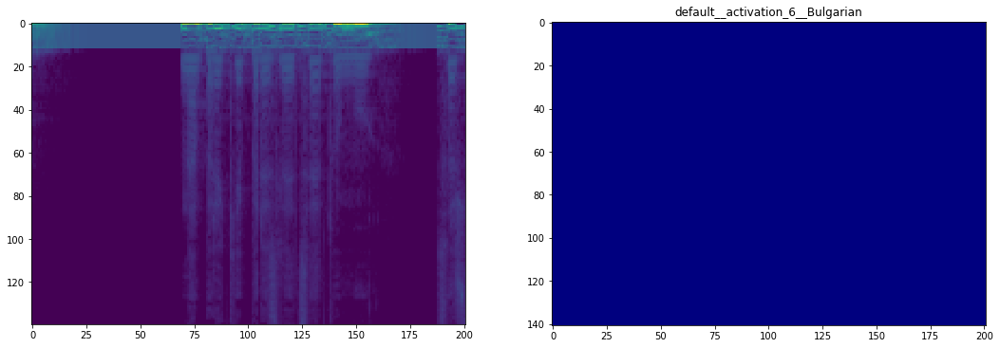

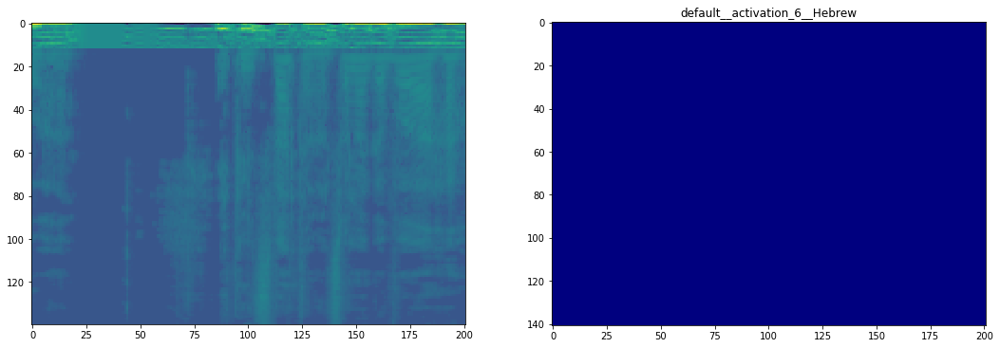

In [31]:
# This corresponds to the Dense linear layer.
for layer_idx in range(20):
    # try:
    # print '!!!!!!!!!!!!!!!', layer_idx
    for class_idx in np.arange(10):
        x = FEATURES[class_idx][2]
        f, ax = plt.subplots(1, 2)
        ax[0].imshow(x[1:, :])

        for i, modifier in enumerate([None]):  # , 'relu']):  # 'guided'
            grads = visualize_saliency(model, layer_idx, filter_indices=class_idx, seed_input=x.reshape(141, 201, 1), backprop_modifier=modifier)
            t = '{}__{}__{}'.format(modifier or 'default', model.layers[layer_idx].name, MAP_CLASS_TO_LANGUAGE[class_idx])
            ax[i+1].set_title(t) 
            ax[i+1].imshow(grads, cmap='jet')

        plt.show()
    # except:
    #     print layer_idx

skip 0
skip 1


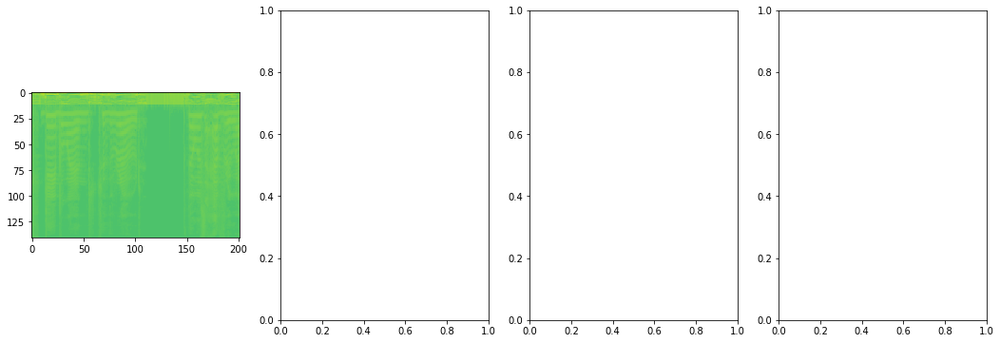

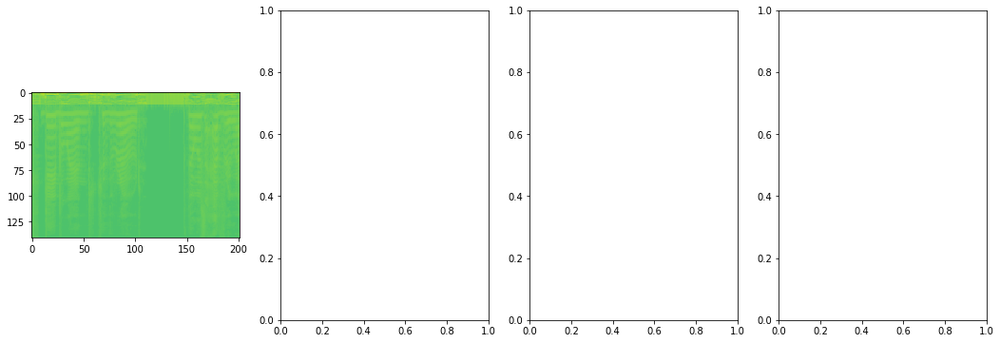

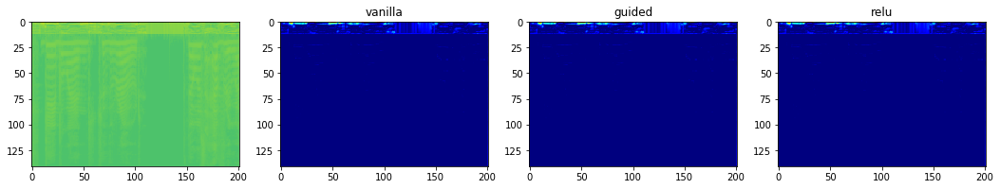

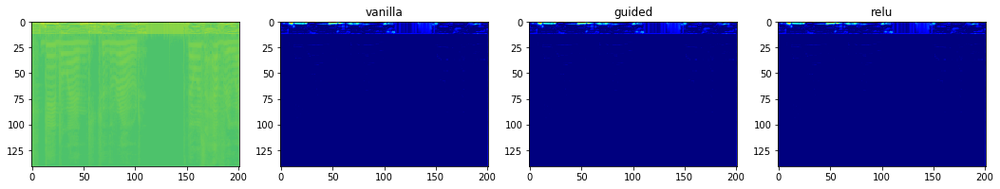

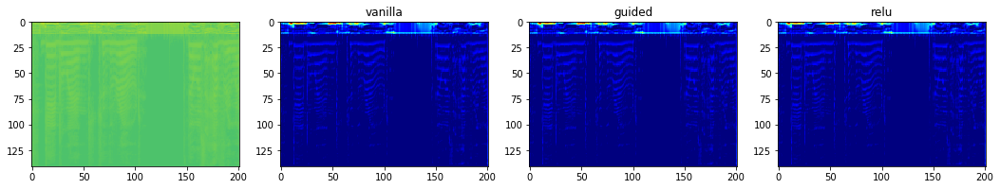

...

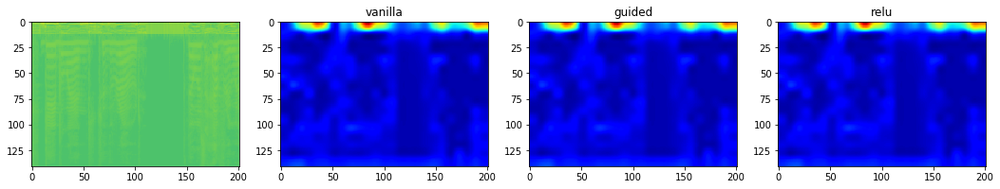

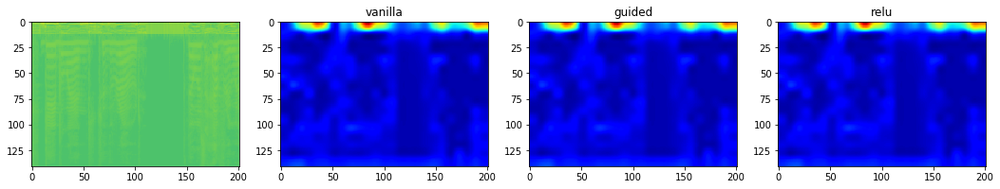

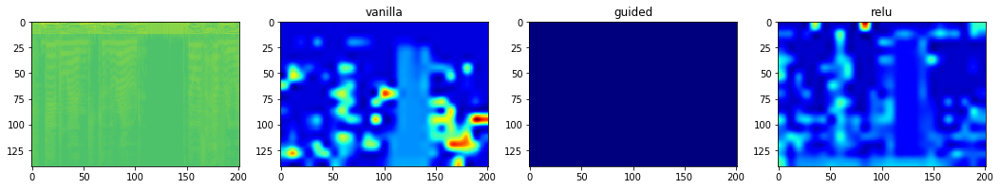

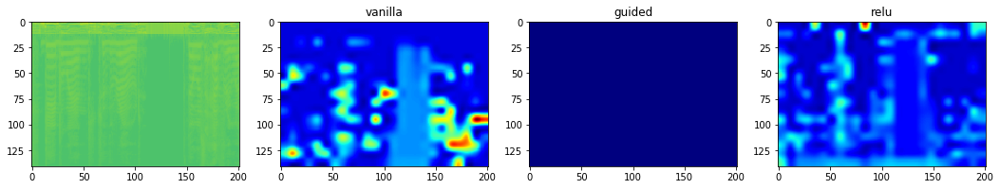

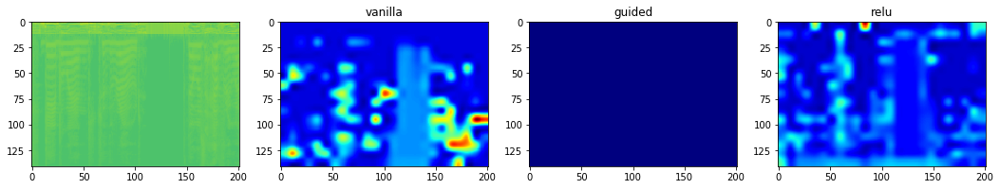

In [27]:
from vis.visualization import visualize_cam

FEATURE_CLASS = 2
x = FEATURES[FEATURE_CLASS][0]
 
for layer in range(20):
    f, ax = plt.subplots(1, 4)
    ax[0].imshow(x)
    
    try:
        for i, modifier in enumerate([None, 'guided', 'relu']):
            seedx = x.reshape(141, 201, 1)
            grads = visualize_cam(model, layer, filter_indices=FEATURE_CLASS, seed_input=seedx, backprop_modifier=modifier) 
            ax[i+1].set_title(modifier or 'vanilla') 
            ax[i+1].imshow(grads, cmap='jet')
        
    except:
        print'skip', layer

### Fit generator

In [17]:
num_classes = 10  # CLASSES_COUNT
droprate = 0.25
input_shape = (141, 201, 1)

model = Sequential()

model.add(Conv2D(128, kernel_size=(2, 2), padding="same", activation='relu', input_shape=input_shape))
model.add(BatchNormalization())

model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', border_mode="same"))
model.add(BatchNormalization())
model.add(MaxPooling2D())
model.add(Dropout(droprate))

model.add(Conv2D(64, kernel_size=(2, 2), activation='relu', border_mode="same"))
model.add(BatchNormalization())
model.add(MaxPooling2D())

model.add(Conv2D(32, kernel_size=(2, 2), activation='relu', border_mode="same"))
model.add(BatchNormalization())
model.add(MaxPooling2D())

model.add(Flatten())
model.add(Dense(256, use_bias=False))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(droprate))
model.add(Dense(128, use_bias=False))
model.add(BatchNormalization())
model.add(Activation('relu'))

model.add(Dense(num_classes))
model.add(Activation('softmax'))
model.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.RMSprop(),
              metrics=['accuracy'])

model.summary()

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:10: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, padding="same", activation="relu", kernel_size=(3, 3))`
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:15: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, padding="same", activation="relu", kernel_size=(2, 2))`
  from ipykernel import kernelapp as app
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:19: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(32, padding="same", activation="relu", kernel_size=(2, 2))`


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 141, 201, 128)     640       
_________________________________________________________________
batch_normalization_1 (Batch (None, 141, 201, 128)     512       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 141, 201, 64)      73792     
_________________________________________________________________
batch_normalization_2 (Batch (None, 141, 201, 64)      256       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 70, 100, 64)       0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 70, 100, 64)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 70, 100, 64)       16448     
__________

In [14]:
X_TRAIN_FILES, Y_TRAIN_FILES, X_TEST_FILES, Y_TEST_FILES = [], [], [], []
test_size = 0.3

for c, files in MAP_CLASS_TO_FILES_LIST.iteritems():
    random.shuffle(files)
    count_test_files = int(test_size * len(files))
    
    X_TEST_FILES.extend(files[:count_test_files])
    X_TRAIN_FILES.extend(files[count_test_files:])
    Y_TEST_FILES.extend([c for _ in xrange(count_test_files)])
    Y_TRAIN_FILES.extend([c for _ in xrange(len(files) - count_test_files)])

CLASSES_COUNT = len(set(Y_TRAIN_FILES))
Y_TRAIN_FILES = keras.utils.np_utils.to_categorical(Y_TRAIN_FILES)
Y_TEST_FILES = keras.utils.np_utils.to_categorical(Y_TEST_FILES)
print len(X_TRAIN_FILES), len(Y_TRAIN_FILES), len(X_TEST_FILES), len(Y_TEST_FILES)

22771 22771 9745 9745


In [15]:
def generator(X, Y, batch_size, reuse=True):
    batches_counter = 0
    
    while True:
        cur_batch_X = []
        cur_batch_Y = []

        batch_iter = (batch_size * batches_counter) % len(X)
        batches_counter += 1
        
        while len(cur_batch_X) < batch_size:
            file_path = X[batch_iter]
            cur_batch_X.append(get_wav_feature(file_path))
            cur_batch_Y.append(Y[batch_iter])
            
            batch_iter += 1

            if batch_iter == len(X):
                if not reuse:
                    raise StopIteration
                else:
                    batch_iter = 0
        
        res = np.array(cur_batch_X)
        res = np.expand_dims(res, axis=3)
        print batches_counter, os.getpid()
        yield res, np.array(cur_batch_Y)

In [16]:
batch_size = 128
batches_count = len(X_TRAIN_FILES[:500]) / batch_size
print batches_count

history = model.fit_generator(
    generator(X_TRAIN_FILES[:500], Y_TRAIN_FILES[:500], batch_size),
    steps_per_epoch=batches_count,
    epochs=3
)

3


RuntimeError: The model needs to be compiled before being used.

In [21]:
input_shape = (2, 2, 1)

model = Sequential()

model.add(Conv2D(128, kernel_size=(2, 2), padding="same", activation='relu', input_shape=input_shape))
model.add(BatchNormalization())
model.add(Flatten())
model.add(Dense(21))
model.add(Activation('softmax'))
model.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.RMSprop(),
              metrics=['accuracy'])

model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 2, 2, 128)         640       
_________________________________________________________________
batch_normalization_3 (Batch (None, 2, 2, 128)         512       
_________________________________________________________________
flatten_3 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 21)                10773     
_________________________________________________________________
activation_1 (Activation)    (None, 21)                0         
Total params: 11,925
Trainable params: 11,669
Non-trainable params: 256
_________________________________________________________________


In [22]:
data_x = [[[1, 1], [1, 1]] for _ in xrange(1000)]
data_y = [i % 21 for i in xrange(1000)]
data_y = keras.utils.np_utils.to_categorical(data_y)

In [23]:
def test_generator(X, Y, batch_size, reuse=True):
    batches_counter = 0
    
    while True:
        cur_batch_X = []
        cur_batch_Y = []

        batch_iter = (batch_size * batches_counter) % len(X)
        batches_counter += 1
        
        while len(cur_batch_X) < batch_size:
            file_path = X[batch_iter]
            cur_batch_X.append(file_path)
            cur_batch_Y.append(Y[batch_iter])
            
            batch_iter += 1

            if batch_iter == len(X):
                if not reuse:
                    raise StopIteration
                else:
                    batch_iter = 0
        
        res = np.array(cur_batch_X)
        res = np.expand_dims(res, axis=3)
        print batches_counter, os.getpid()
        yield res, np.array(cur_batch_Y)

In [24]:
history = model.fit_generator(
    test_generator(data_x, data_y, 64),
    steps_per_epoch=3,
    epochs=3
)

1Epoch 1/3 
5711
2 5711
3 5711
4 5711
5 5711
6 5711
7 5711
8 5711
9 5711
10 5711
11 5711
1/3 [=========>....................] - ETA: 0s - loss: 3.3481 - acc: 0.046912 5711
13 5711
3/3 [==============================] - 0s 81ms/step - loss: 3.1784 - acc: 0.0469
Epoch 2/3
14 5711
1/3 [=========>....................] - ETA: 0s - loss: 3.0519 - acc: 0.046915 5711
16 5711
3/3 [==============================] - 0s 7ms/step - loss: 3.0517 - acc: 0.0469
Epoch 3/3
1/3 [=========>....................] - ETA: 0s - loss: 3.0578 - acc: 0.046917 5711
18 5711
19 5711
3/3 [==============================] - 0s 6ms/step - loss: 3.0555 - acc: 0.0469


In [28]:
model.save('/home/kolegor/qwe')

### Dataset info

In [5]:
import wave
import contextlib
def get_wav_duration(path):
    with contextlib.closing(wave.open(path,'r')) as f:
        frames = f.getnframes()
        rate = f.getframerate()
        duration = frames / float(rate)
        return duration

In [6]:
base1 = '/home/kolegor/Study/Master/data/use2big_wav_big'
count_by_language = defaultdict(int)
total_length_by_language = defaultdict(int)
for dirname in os.listdir(base1):
    for filename in os.listdir(os.path.join(base1, dirname)):
        filepath = os.path.join(base1, dirname, filename)
        count_by_language[dirname] += 1
        total_length_by_language[dirname] += get_wav_duration(filepath)
for language in total_length_by_language.keys():
    total_length_by_language[language] /= 60.0

In [7]:
base1 = '/home/kolegor/Study/Master/data/use2big_wav_big_splitted_5'
count_splitted_by_language = defaultdict(int)
count_unique_speakers = defaultdict(set)
for dirname in os.listdir(base1):
    for filename in os.listdir(os.path.join(base1, dirname)):
        count_splitted_by_language[dirname] += 1
        count_unique_speakers[dirname].add(filename.split('.mp3')[0].split('/')[-1].split('_')[0])

In [8]:
sum_files = 0
sum_duration = 0
sum_chunks = 0
sum_speakers = 0
for language in set(count_by_language.keys()):
    print u'{:<15} & {:<5} & {:<20} & {:<10} & {:<10} \\\\'.format(
        language,
        count_by_language[language],
        u'{:.2f} ({:.2f})'.format(total_length_by_language[language], total_length_by_language[language] / 60.0),
        count_splitted_by_language[language],
        len(count_unique_speakers[language]) + 1
    )
    sum_files += count_by_language[language]
    sum_duration += total_length_by_language[language]
    sum_chunks += count_splitted_by_language[language]
    sum_speakers += len(count_unique_speakers[language]) + 1
print u'123 & {:<5} & {:<10} & {:<10} & {:<10} \\\\'.format(
    sum_files,
    u'{:.2f} ({:.2f})'.format(sum_duration, sum_duration / 60.0),
    sum_chunks,
    sum_speakers
)

Swedish         & 54    & 1010.48 (16.84)      & 11784      & 6          \\
Portuguese      & 85    & 853.44 (14.22)       & 9707       & 24         \\
Chinese         & 178   & 1113.57 (18.56)      & 12240      & 6          \\
German          & 152   & 1813.71 (30.23)      & 20805      & 16         \\
Poland          & 40    & 753.89 (12.56)       & 8792       & 6          \\
Spanish         & 112   & 1140.38 (19.01)      & 12974      & 6          \\
French          & 269   & 3114.56 (51.91)      & 35681      & 5          \\
Hebrew          & 113   & 1266.34 (21.11)      & 14483      & 6          \\
Russian         & 129   & 1106.00 (18.43)      & 12464      & 56         \\
English         & 213   & 3289.43 (54.82)      & 38128      & 6          \\
Italian         & 176   & 2373.85 (39.56)      & 27377      & 6          \\
123 & 1521  & 17835.66 (297.26) & 204435     & 143        \\
